# Data analysis: Velib

Author: O. Roustant, INSA Toulouse. February 2023.

Students: Assoulant-Anduze Justine, Dumercq Margot, Duval Théo, Otero Nicolas, 4MA


We consider the ‘Vélib’ data set, related to the bike sharing system of Paris. The data are loading profiles of the bike stations over one week, collected every hour, from the period Monday 2nd Sept. - Sunday 7th Sept., 2014. The loading profile of a station, or simply loading, is defined as the ratio of number of available bikes divided by the number of bike docks. A loading of 1 means that the station is fully loaded, i.e. all bikes are available. A loading of 0 means that the station is empty, all bikes have been rent.

From the viewpoint of data analysis, the individuals are the stations. The variables are the 168 time steps (hours in the week). The aim is to detect clusters in the data, corresponding to common customer usages. This clustering should then be used to predict the loading profile.

# 1. Data Loading

In [249]:
library(mclust)
library(cluster)
library(factoextra)
library(FactoMineR)
library(ppclust)
library(reticulate)
library(ggplot2)
library(reshape)
library(corrplot)
library(gridExtra)
library(circlize)
library(ggpubr)  #to get the ggarrange function

In [250]:
rm(list = ls())   # erase everything, start from scratch!

# direct loading from stored data on Moodle
load("velib.RData")
install.packages("ggmap")
library("ggmap")
# alternative: load the data from package funFEM, where you have more information (help page)



Warning message:
"le package 'ggmap' est en cours d'utilisation et ne sera pas installé"


In [251]:
install.packages("funFEM")
library(funFEM)
data(velib)
help("velib")
# data preparation
x <- as.matrix(velib$data)
colnames(x) <- 1:ncol(x)
rownames(x) <- velib$names

n <- nrow(x)
stations <- 1:n 
coord <- velib$position[stations,]

# select exactly 7 days of data (we remove the first 13 dates)
dates <- 14:181
x <- x[stations, dates]
colnames(x) <- 1:length(dates)

Warning message:
"le package 'funFEM' est en cours d'utilisation et ne sera pas installé"


In [252]:
timeTick <- 1 + 24*(0:6)  # vector corresponding to the beginning of days
par(mfrow = c(1, 1))

options(repr.plot.width = 15, repr.plot.height = 6)


# 2. Descriptive statistics.

1. Draw a matrix of plots of size 4*4, corresponding to the first 16 stations. (Do not forget the vertical lines corresponding to days).


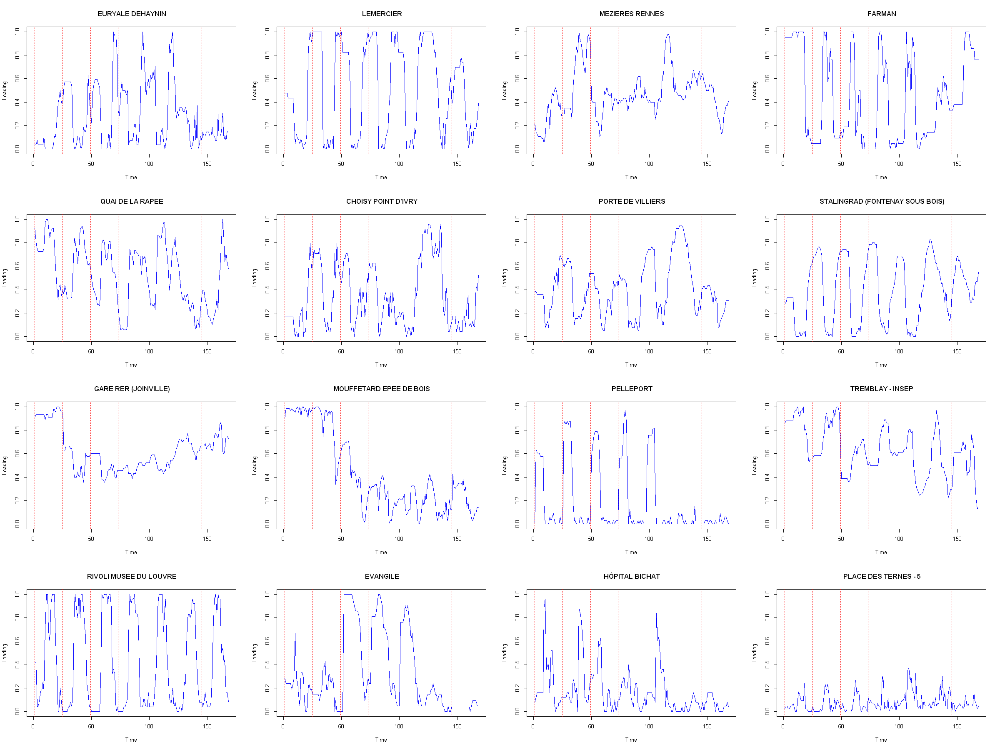

In [253]:
#question 1
options(repr.plot.width=20,repr.plot.height=15)
par (mfrow=(c(4,4)))
for (i in 1:16){
    plot(x[i, ], col = "blue", type = "l", ylim = c(0, 1), 
     xlab = "Time", ylab = "Loading", main = rownames(x)[i])
abline(v = timeTick, lty = "dotted",col='red')
}

In [254]:
# From now on, we use numbers instead of station names, 
# in order to simplify printing
rownames(x) <- 1:nrow(x)

2. Draw the boxplot of the variables, sorted in time order. 
What can you say about the distribution of the variables? 
Position, dispersion, symmetry? Can you see a difference between days?


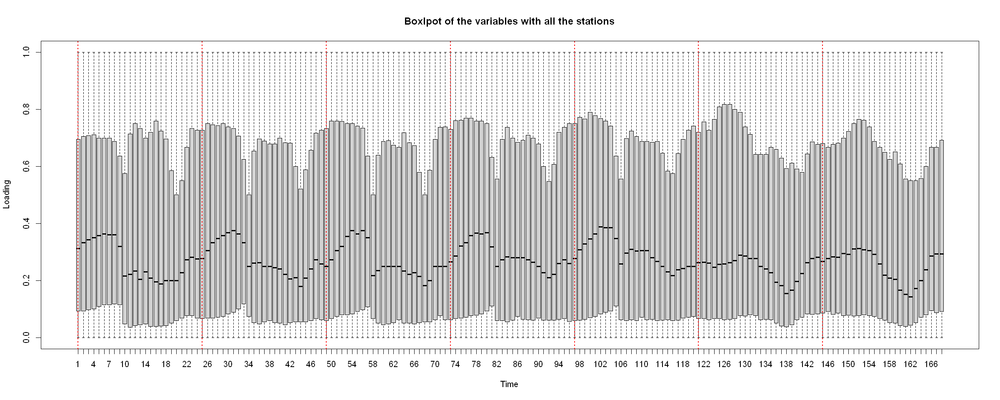

In [255]:
#question 2
options(repr.plot.width=20,repr.plot.height=8)
boxplot(x, xlab="Time",ylab="Loading",main="Boxlpot of the variables with all the stations")
abline(v=timeTick,lty="dotted", col="red",lwd=2)

La distribution des variables est similaire pour les jours de la semaine mais diffère en week-end (effet périodique). Il y a une plus forte utilisation en wk car loading plus petit.
La dispersion est très importante. 25% des valeurs sont au-dessus de 0.8 la nuit en semaine, les vélos sont peu utilisés contrairement en début de soirée en wk où 50% des stations sont remplies qu'à 20%. Pas symétrique car pas centré sur médiane

3. Plot the average hourly loading for each day (on a single graph).
Comments? 


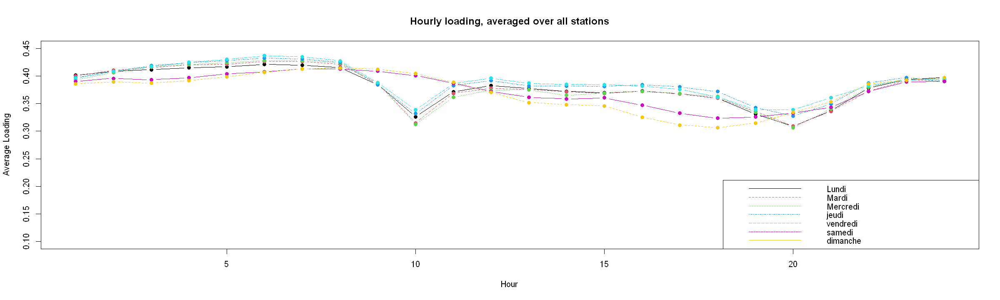

In [256]:
options(repr.plot.width=20,repr.plot.height=6)
xHour<-colMeans(x)
xHour<-matrix(xHour,nrow=24)
dayText<-c("Lundi","Mardi","Mercredi","jeudi","vendredi","samedi","dimanche")
dayText<-paste(dayText,"")
matplot(xHour,type="b",ylim=c(0.1,0.45),col=1:7,pch=19,xlab = "Hour", ylab = 'Average Loading',main= "Hourly loading, averaged over all stations")
legend("bottomright", legend = dayText, lty = 1:7, col = 1:7)



4. Plot the stations coordinates on a 2D map (latitude versus longitude). Use the package ggmap (function 'qmplot') to visualize the average loading for a given hour (6h, 12h, 23h) as a color scale.
Comments ?


ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



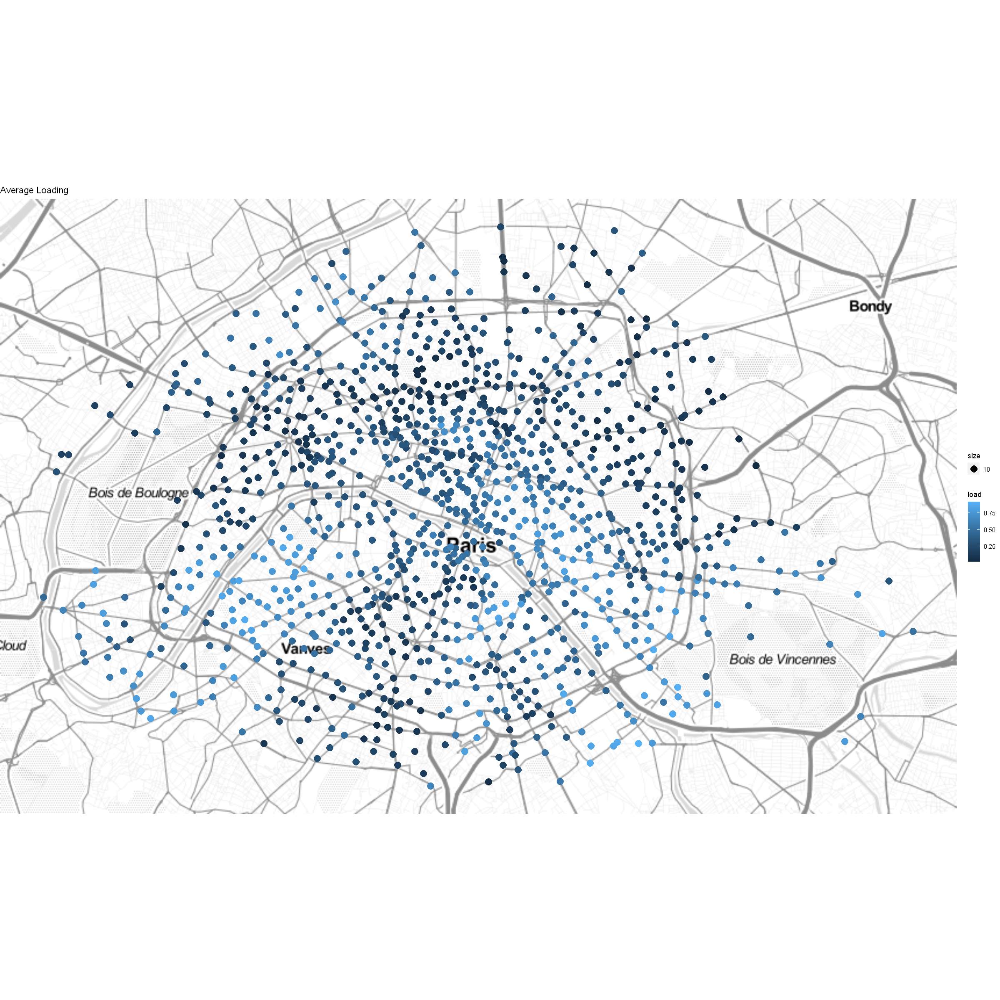

In [257]:
#question 4
#Average Loading
options(repr.plot.width = 20, repr.plot.height = 20)
load<- rowMeans(x)
qmplot(longitude,latitude,data=velib$position,color=load,zoom=12,size=10,main="Average Loading")


ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



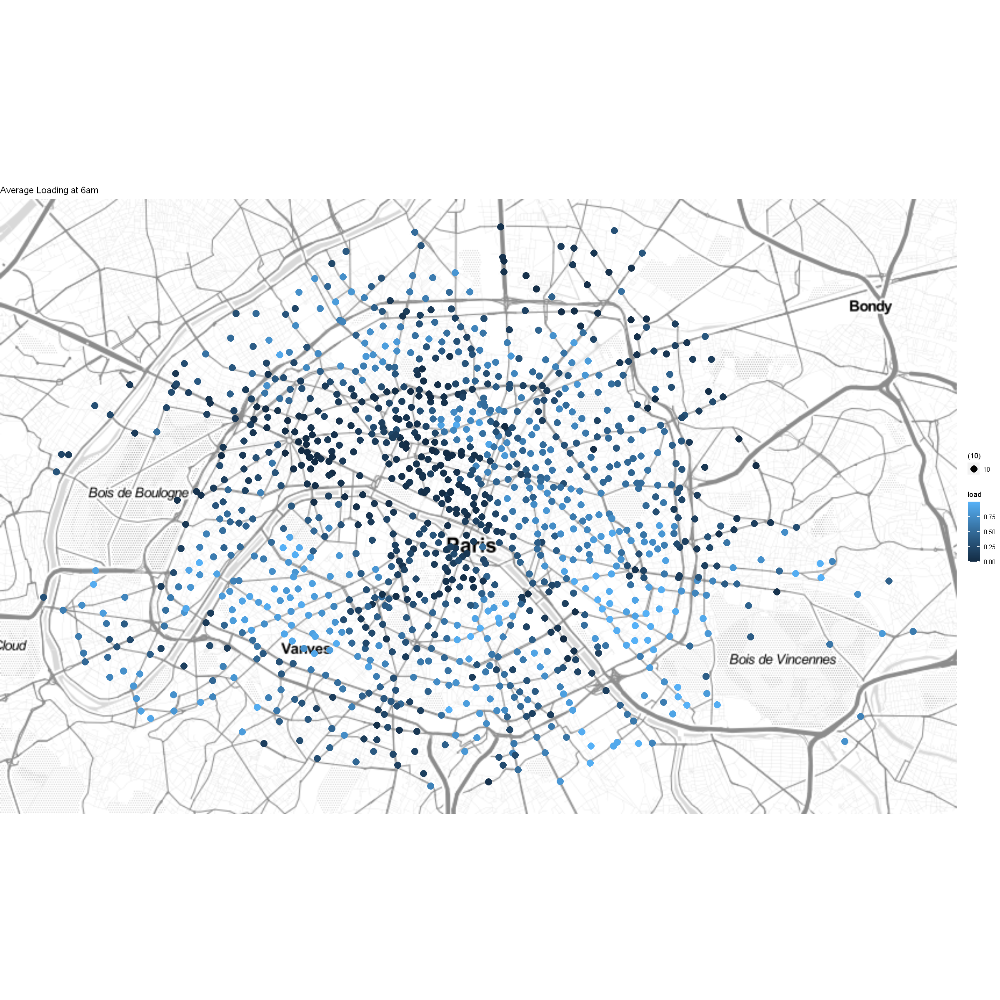

In [258]:
#Average Loading at 6am
load<- rowMeans(x[,seq(6,168,by=24)])
qmplot(longitude,latitude,data=velib$position,color=load,zoom=12,size=(10),main="Average Loading at 6am")

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



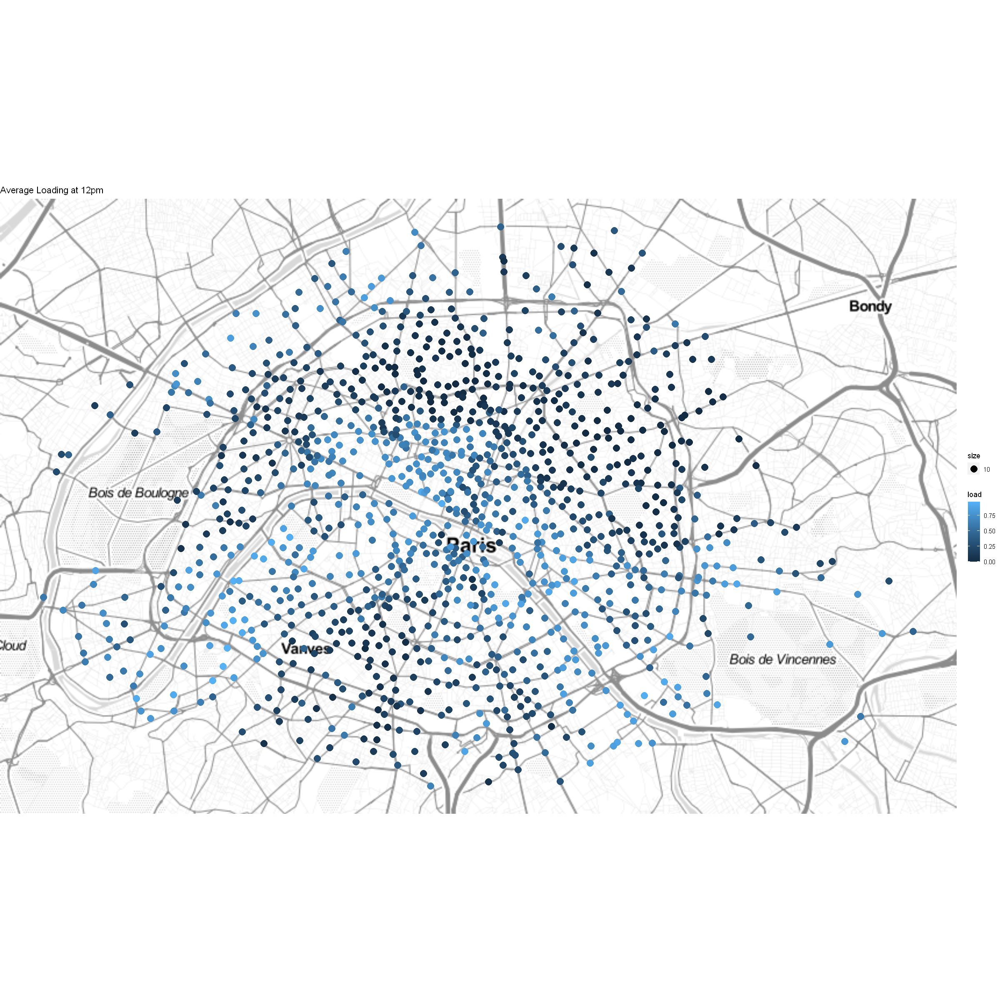

In [259]:
#Average Loading at 12pm
load<- rowMeans(x[,seq(12,168,by=24)])
qmplot(longitude,latitude,data=velib$position,color=load,zoom=12,size=10,main="Average Loading at 12pm")

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



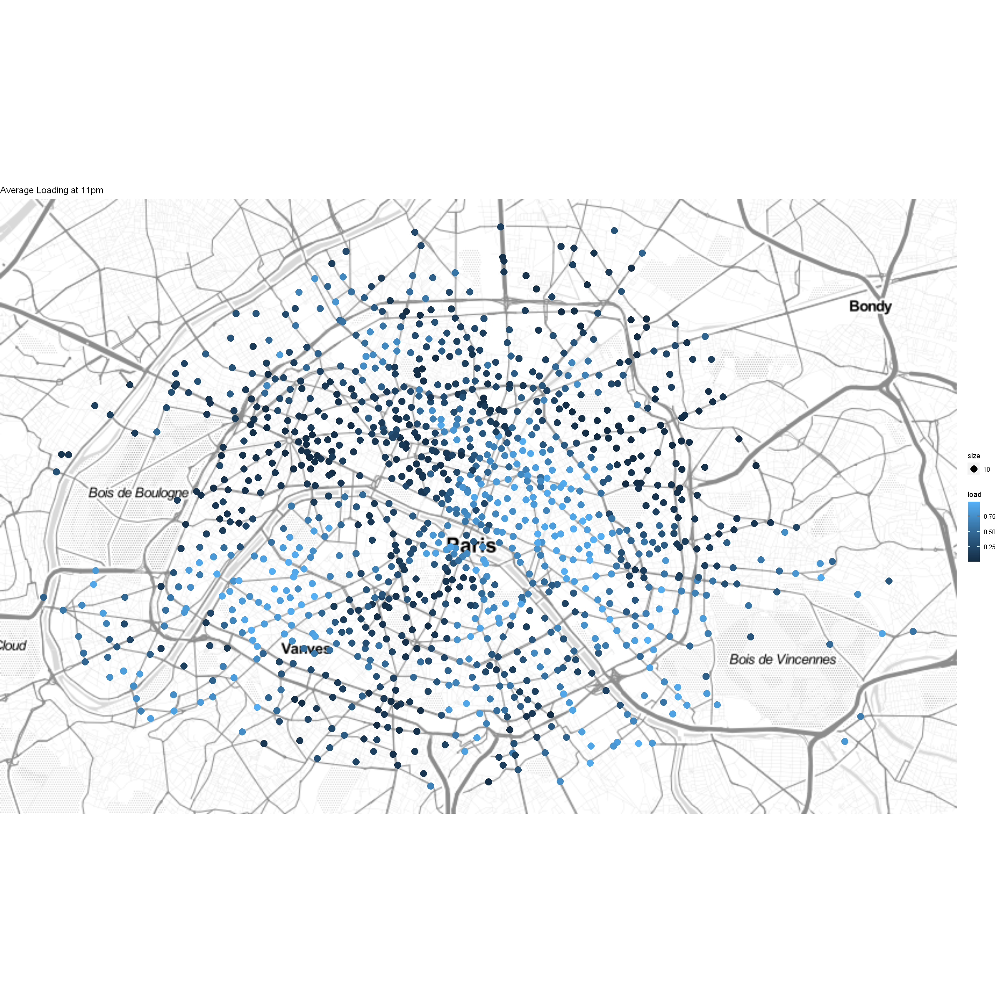

In [260]:
#Average Loading at 11pm
gradient.cols = c("#00AFBB", "#E7B800", "#FC4E07")
load<- rowMeans(x[,seq(23,168,by=24)])
qmplot(longitude,latitude,data=velib$position,color=load,zoom=12,size=10,main="Average Loading at 11pm")

5. Use a different color for stations which are located on a hill. (Use the basis 'plot' function, and the function 'qmplot' of R package ggmap).


ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



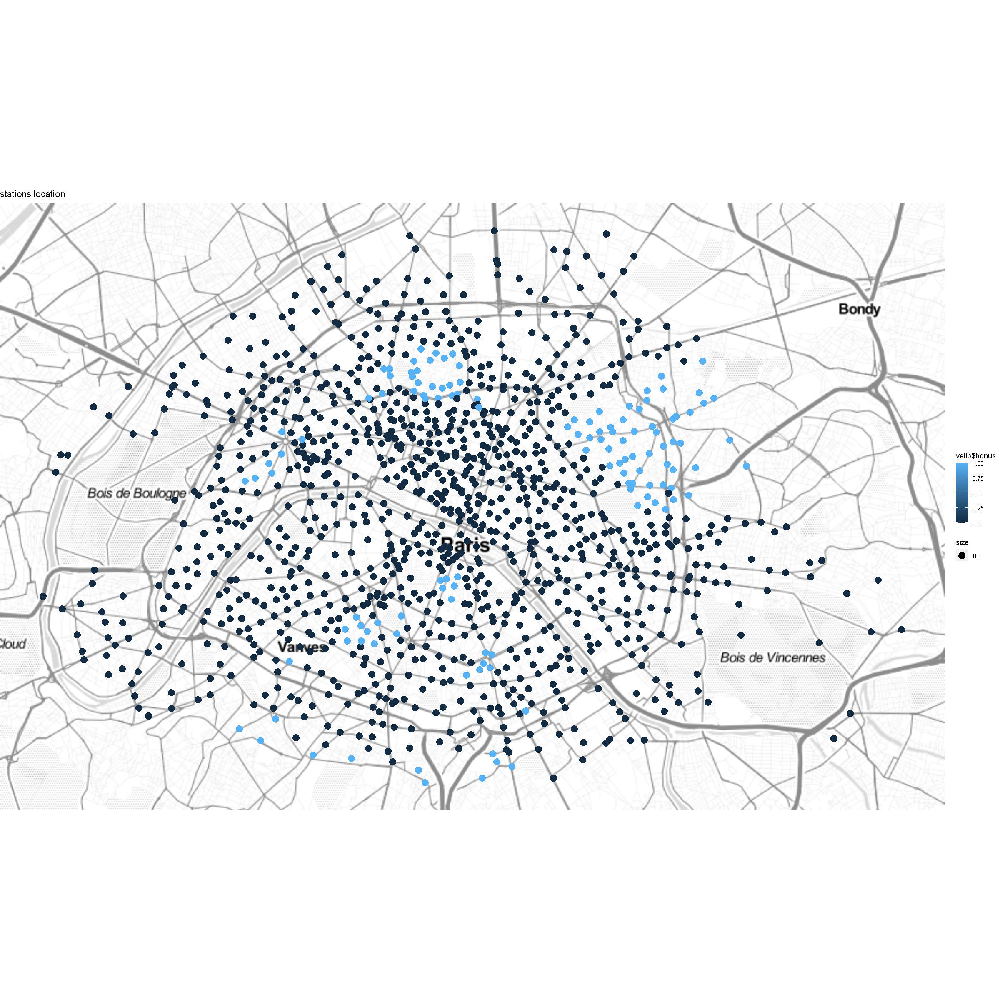

In [261]:
#question 5
#station location
qmplot(longitude,latitude,data=velib$position,color=velib$bonus,zoom=12,size=10,main="stations location")

6. Redo questions 1-3 for the subset of stations which are located on a hill. Same questions for those who are not. Comment?


In [262]:
#question 6
xHill <- x[velib$bonus == 1, ]
xNoHill <- x[velib$bonus == 0, ]

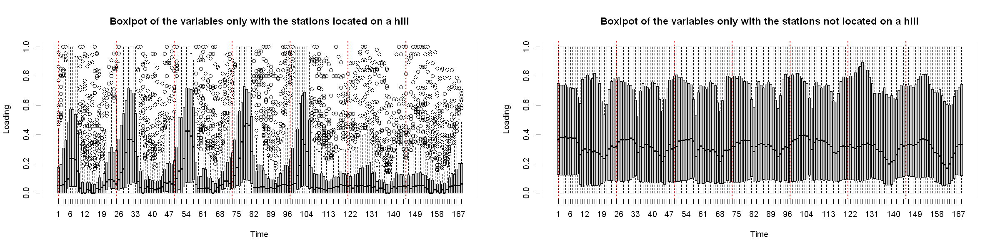

In [263]:
options(repr.plot.width=20,repr.plot.height=5)
par (mfrow=(c(1,2)))
boxplot(xHill, xlab="Time",ylab="Loading",main="Boxlpot of the variables only with the stations located on a hill")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
boxplot(xNoHill, xlab="Time",ylab="Loading",main="Boxlpot of the variables only with the stations not located on a hill")
abline(v=timeTick,lty="dotted", col="red",lwd=2)

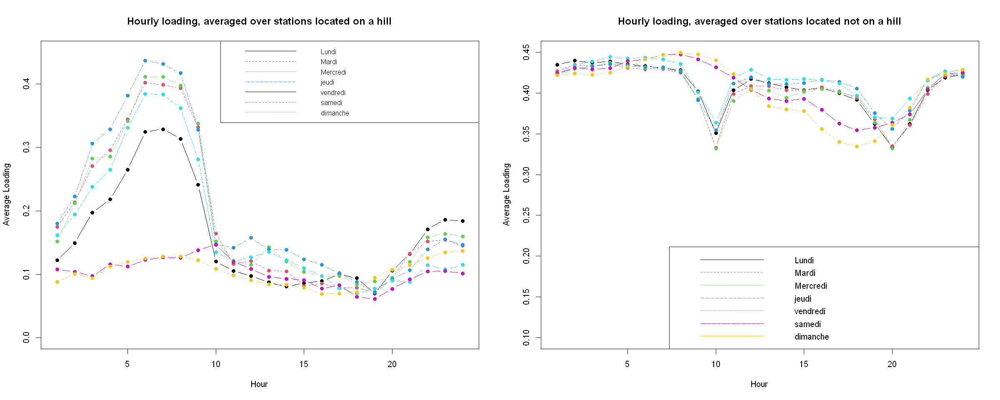

In [264]:
options(repr.plot.width=20,repr.plot.height=8)
par (mfrow=(c(1,2)))
xHourHill<-colMeans(xHill)
xHourHill<-matrix(xHourHill, nrow=24)
matplot(xHourHill,type="b",ylim=c(0.,0.45),col=1:7,pch=19, xlab="Hour", ylab = 'Average Loading', main= "Hourly loading, averaged over stations located on a hill")
legend("topright", legend = dayText, lty = 1:4, col = 1:4,cex=0.8)


xHourNoHill <-colMeans(xNoHill)
xHourNoHill<-matrix(xHourNoHill, nrow=24)
matplot(xHourNoHill,type="b",ylim=c(0.1,0.45),col=1:7,pch=19,  xlab="Hour", ylab = 'Average Loading', main= "Hourly loading, averaged over stations located not on a hill")
legend("bottomright", legend = dayText, lty = 1:7, col = 1:7)


Forte différence entre les stations qui sont situées ou non sur des collines.

En ce qui concerne les stations situées sur des collines, le contraste entre les jours de la semaine et les week-ends est très net.

Tandis que pour les autres stations, le chargement est beaucoup plus similaire.

D'une manière générale, le taux de chargement des stations situées sur les collines est inférieur à celui des autres stations. Potentiellement parce que les gens prennent les vélos pour descendre de la colline mais ne les rapporte pas à cause de la montée!

# 3. Principal Component Analysis

In [265]:
head(cor(x))

,1,2,3,4,5,6,7,8,9,10,⋯,159,160,161,162,163,164,165,166,167,168
1,1.0000000,0.9385132,0.8815616,0.8616092,0.8171012,0.7724756,0.7708562,0.7625427,0.7323196,0.5723276,⋯,0.5129898,0.4824323,0.4434349,0.4404559,0.4831063,0.5493375,0.6110453,0.6436365,0.6635124,0.6687479
2,0.9385132,1.0000000,0.9420438,0.9203411,0.8747894,0.8312244,0.8262467,0.8141597,0.7780584,0.5501050,⋯,0.4691572,0.4411317,0.3965343,0.3854507,0.4364567,0.4960537,0.5615387,0.5998748,0.6280041,0.6396231
3,0.8815616,0.9420438,1.0000000,0.9786457,0.9346615,0.8910479,0.8825817,0.8700555,0.8198952,0.5276286,⋯,0.4252660,0.3943800,0.3467636,0.3415384,0.3960305,0.4585498,0.5264243,0.5615080,0.5904807,0.6080048
4,0.8616092,0.9203411,0.9786457,1.0000000,0.9572134,0.9135550,0.9045040,0.8912418,0.8334669,0.5170892,⋯,0.4135704,0.3789555,0.3318415,0.3275894,0.3893488,0.4479296,0.5269801,0.5609379,0.5939733,0.6124558
5,0.8171012,0.8747894,0.9346615,0.9572134,1.0000000,0.9586088,0.9506376,0.9381995,0.8661519,0.5030308,⋯,0.3913548,0.3527924,0.3045758,0.2974506,0.3570125,0.4142792,0.4998829,0.5333637,0.5676972,0.5886126
6,0.7724756,0.8312244,0.8910479,0.9135550,0.9586088,1.0000000,0.9922688,0.9801614,0.8906919,0.4947539,⋯,0.3610544,0.3174291,0.2698154,0.2678185,0.3294953,0.3883178,0.4710353,0.5079449,0.5407788,0.5615100


On peut remarquer que les heures proches ont une forte corrélation, ce qui est assez intuitif. Tandis que les heures éloignées beuaocup moins.

In [266]:
options(repr.plot.width=20,repr.plot.height=10)


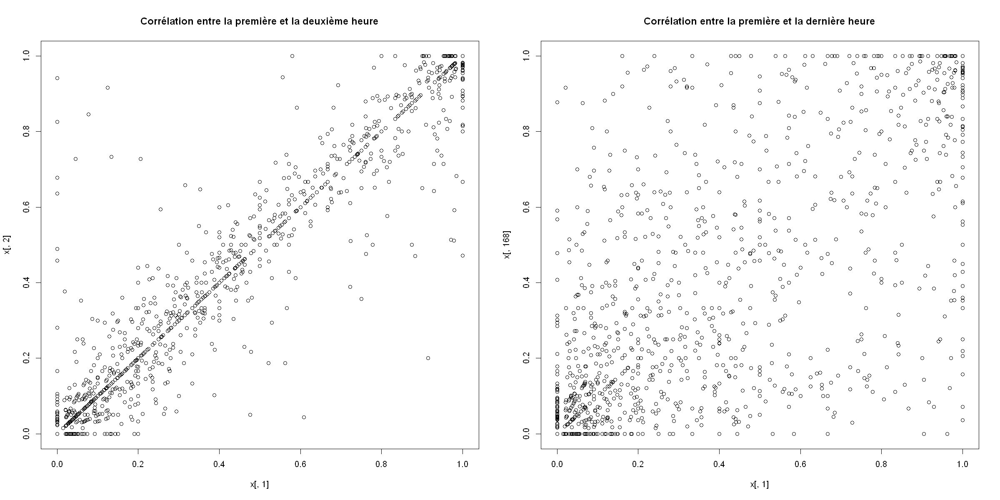

In [267]:
par (mfrow=(c(1,2)))
plot(x[,1], x[,2],col="black",main='Corrélation entre la première et la deuxième heure')
plot(x[,1],x[,168],main='Corrélation entre la première et la dernière heure')

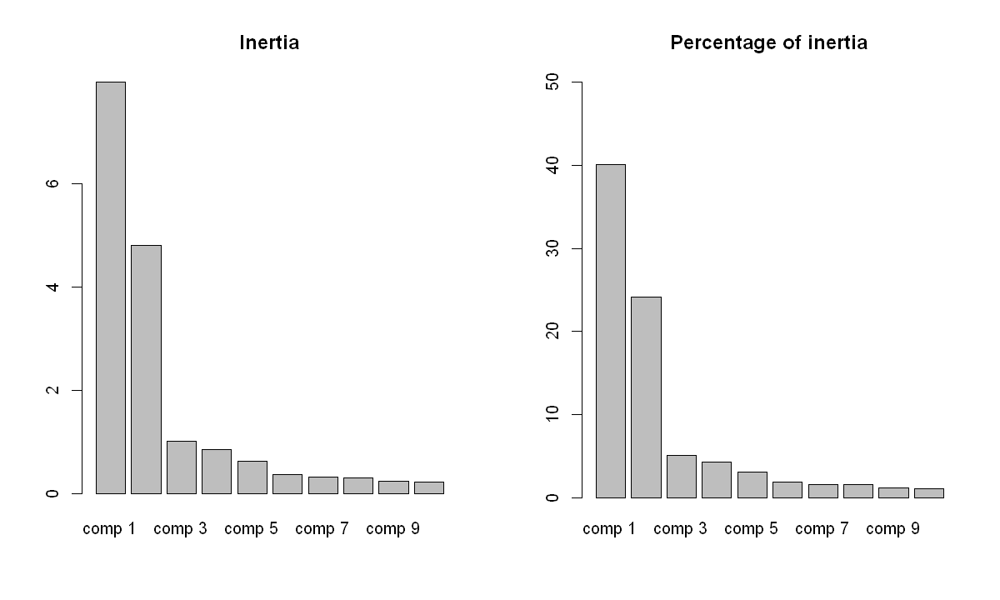

In [268]:
library(FactoMineR)
library(factoextra)
# PCA with FactoMineR
acp <- PCA(x, scale.unit = FALSE, ncp = 168, graph = F)
options(repr.plot.width = 10, repr.plot.height = 6)
# barplot of the inertias and percentage of inertia associated to each principal component
par(mfrow = c(1, 2))
barplot(acp$eig[1:10, 1], main = "Inertia")
barplot(acp$eig[1:10, 2], ylim = c(0, 50), main = "Percentage of inertia")

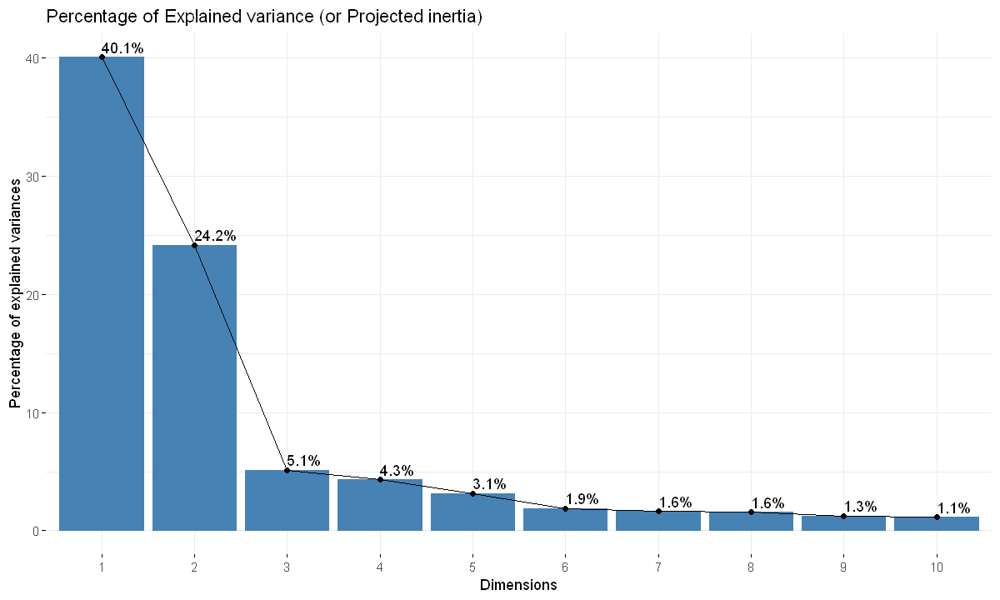

In [269]:
options(repr.plot.width = 10, repr.plot.height = 6)
fviz_eig(acp, addlabels = TRUE, main = "Percentage of Explained variance (or Projected inertia)")

In [270]:
print(sum(acp$eig[1:4, 2]))
print(sum(acp$eig[1:2, 2]))

[1] 73.68437
[1] 64.24086


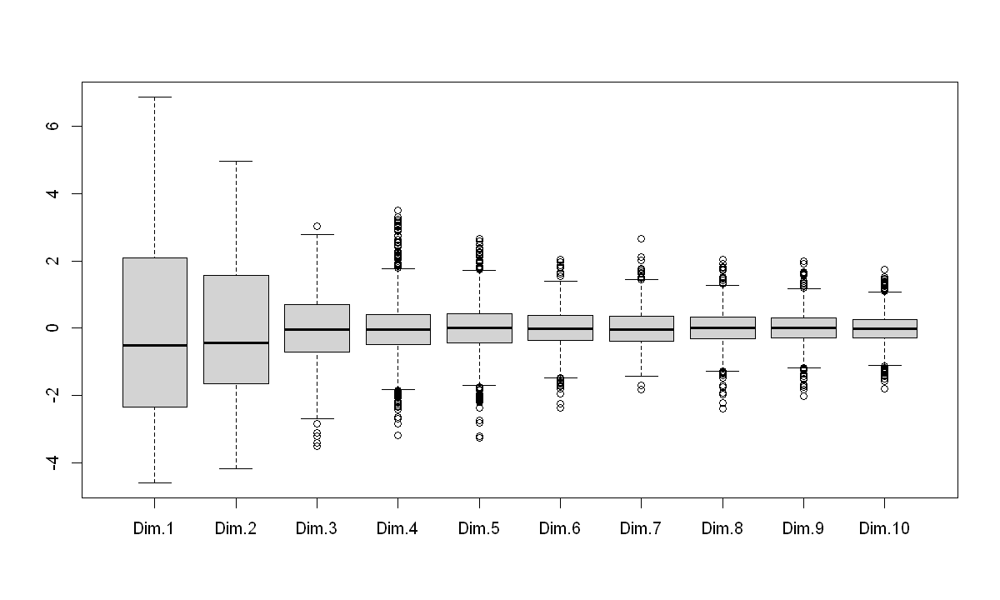

In [271]:
# Distribution of individual coordinates on the principal axes (the "principal components")
boxplot(acp$ind$coord[,1:10])

In [272]:
P <- acp$svd$V


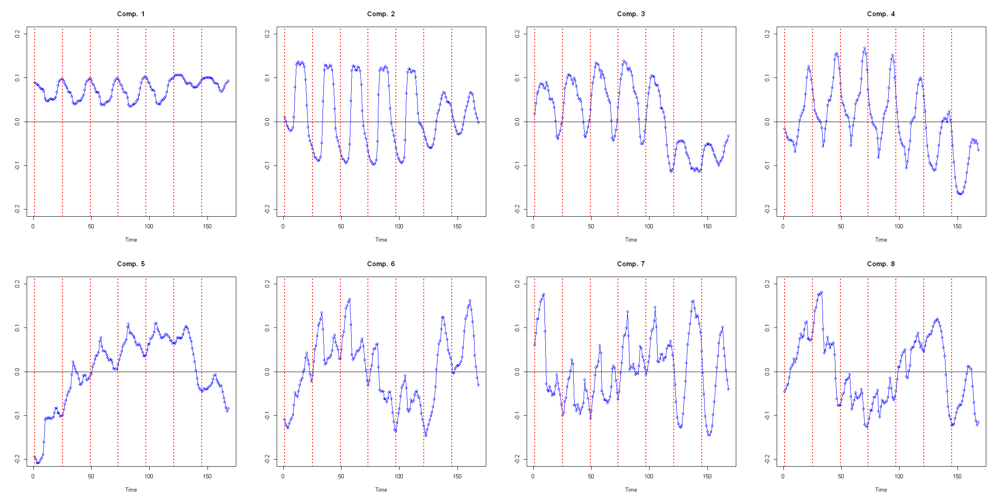

In [273]:
options(repr.plot.width = 20, repr.plot.height = 10)
par(mfrow = c(2, 4))
for (i in 1:8){
    plot(acp$svd$V[, i], type = "o", main = paste("Comp. ", i), xlab = "Time", ylab = "",
         ylim = c(-0.2, 0.2), col = "blue")
    abline(v=timeTick,lty="dotted", col="red",lwd=2)
    abline(h=0)
}


Dim 1: Occupation des stations de velib journalière.  Taux d'occupation moyen

Dim 2: contraste d'occupation des velibs entre le jour et la nuit.

Dim 3: Contraste entre jours de la semaine et week-end.

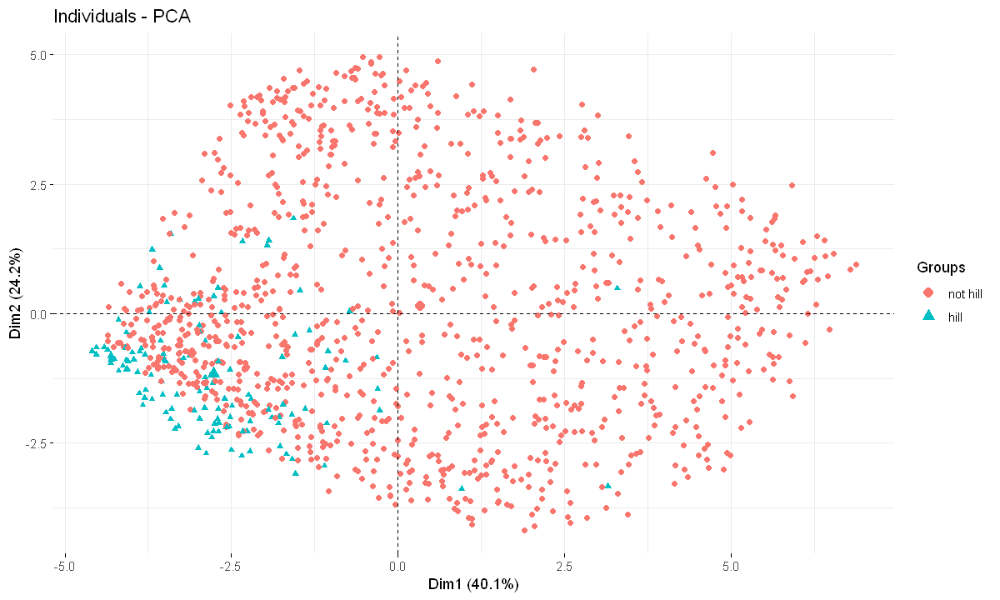

In [274]:

velib$bonus=as.factor(velib$bonus)
velib$bonus=factor(velib$bonus,labels=c("not hill",'hill'))

options(repr.plot.width = 10, repr.plot.height = 6)

ggarrange(
    fviz_pca_ind(acp,axes=c(1,2), geom=c("point"), habillage=velib$bonus))

Les stations de velib les plus à droite sont les plus occupées tandis que celles à gauche sont les moins occupées.

Il y a un fort contraste d'occupation entre le jour et la nuit dans les stations situées en haut du graphe.

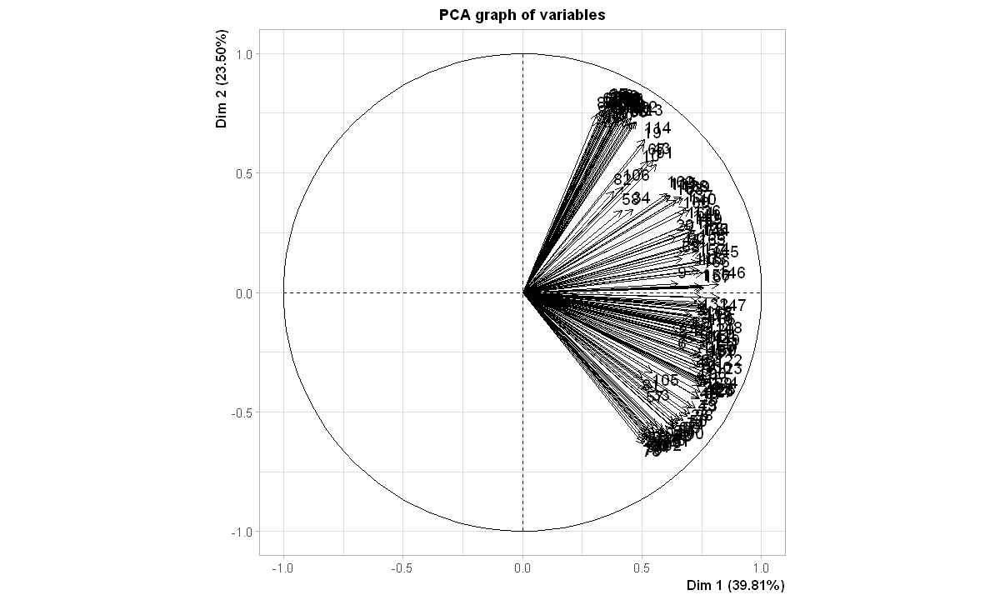

In [275]:
acp <- PCA(x, scale.unit = TRUE, graph = F)
plot(acp, axes = c(1, 2), choix = "var",main="Variables correlation graph")


In [276]:
jour <- c(rep(0,8),rep(1,11),rep(0,5))
jour <- ifelse(jour == 0, "nuit", "jour")
semaine_1 <- rep(jour, 7)

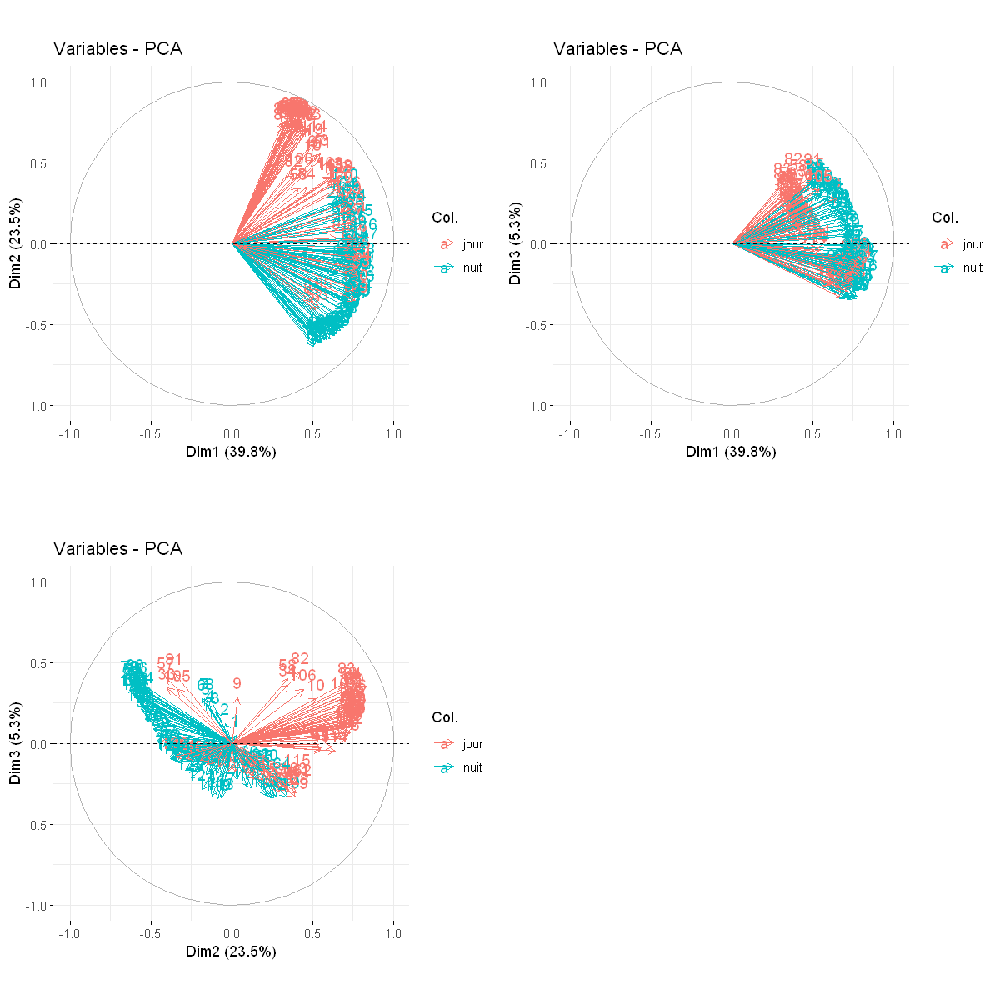

In [358]:
options(repr.plot.width = 10, repr.plot.height = 10)
ggarrange(
fviz_pca_var(acp, axes=c(1,2),col.var = semaine_1),
fviz_pca_var(acp, axes=c(1,3),col.var = semaine_1),
fviz_pca_var(acp, axes=c(2,3),col.var = semaine_1))

Warning message in type.convert.default(colnames(x), dec = "."):
"'as.is' doit être spécifié par l’appelant ; utilisation de TRUE"


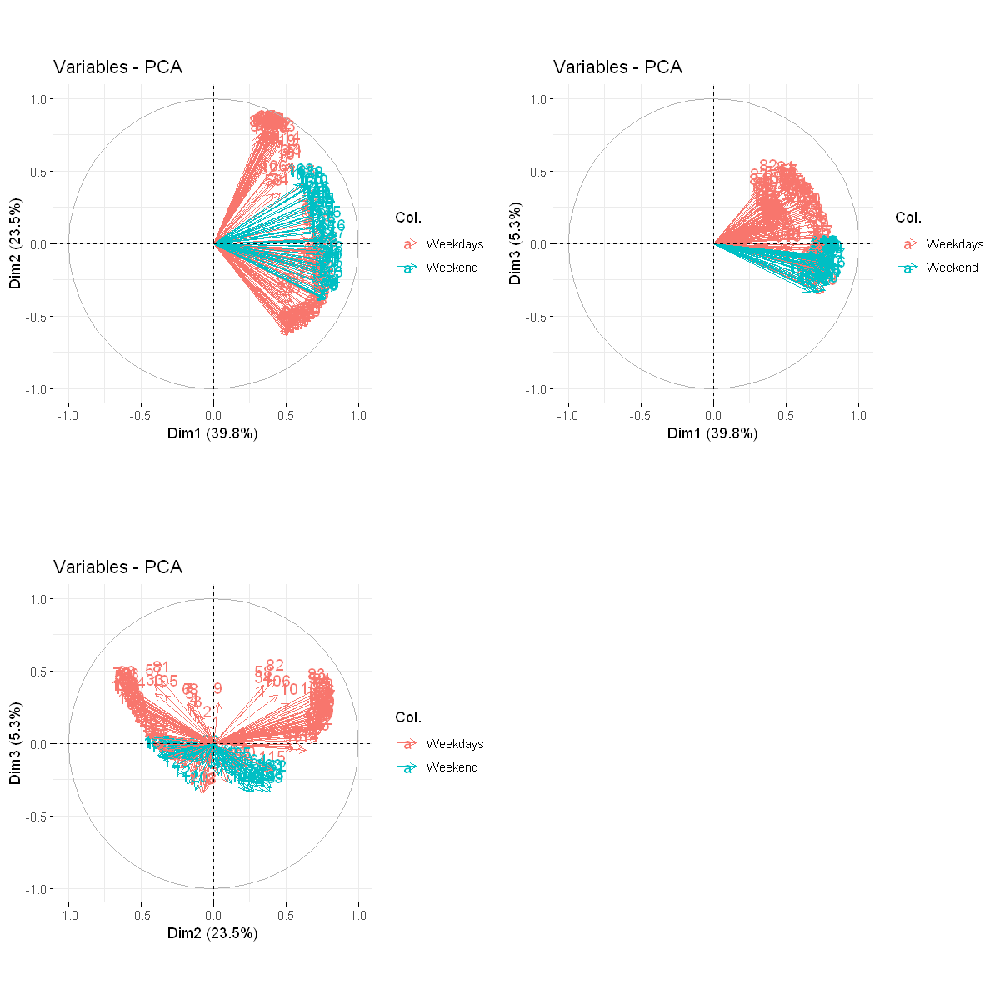

In [359]:
semaine_2<- ifelse(type.convert(colnames(x),dec=".")>=120, "Weekend", "Weekdays")
ggarrange(
fviz_pca_var(acp,axes=c(1,2), col.var=semaine_2),
fviz_pca_var(acp,axes=c(1,3), col.var=semaine_2),
fviz_pca_var(acp,axes=c(2,3), col.var=semaine_2))

# 4. Clustering with $k$-means sur données brutes


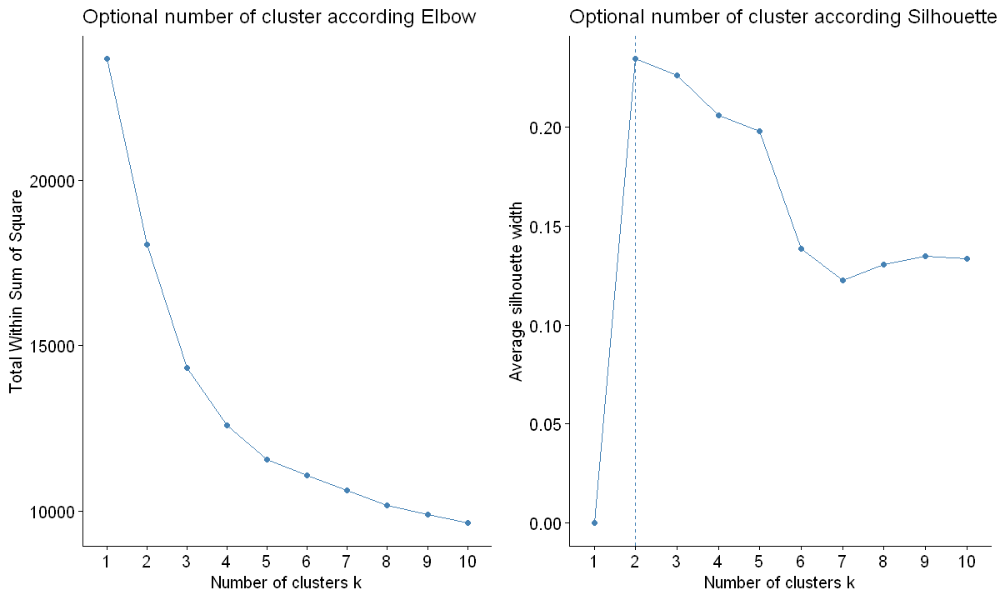

In [279]:
options(repr.plot.width = 10, repr.plot.height = 6)

ggarrange(
    fviz_nbclust(x, FUNcluster=hcut, method="wss") + ggtitle("Optional number of cluster according Elbow"),
    fviz_nbclust(x, FUNcluster=hcut, method="silhouette") + ggtitle("Optional number of cluster according Silhouette")
)

          
             1   2
  not hill 465 597
  hill       3 124

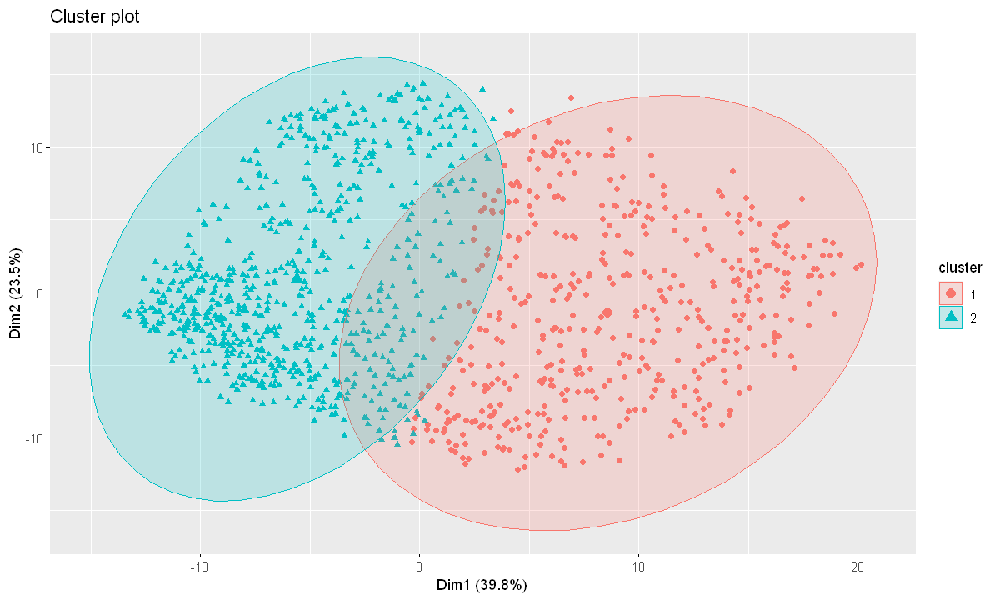

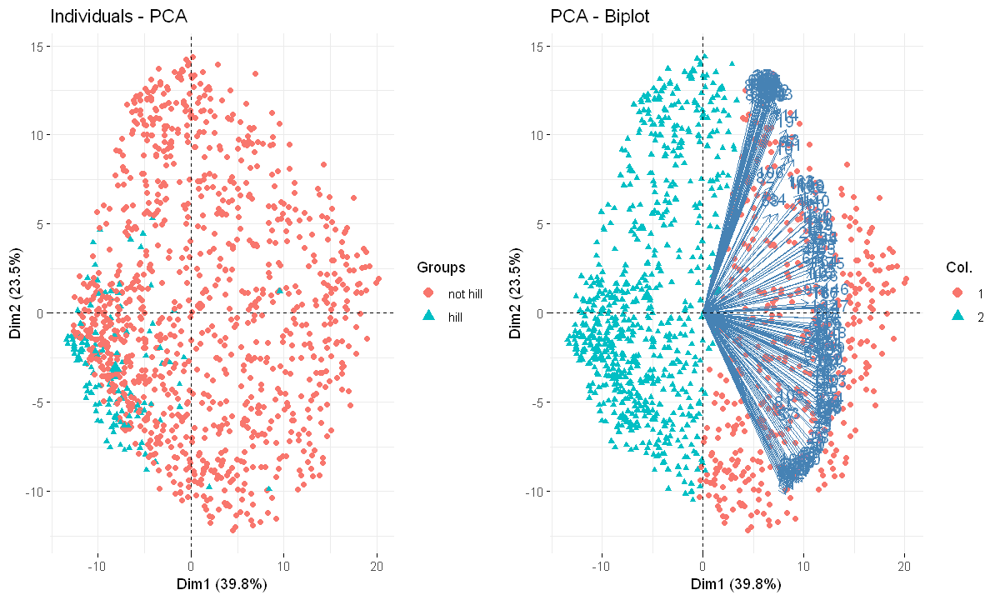

In [280]:
reskmeans2 = kmeans(x, centers=2) 

fviz_cluster(reskmeans2, data=x, ellipse.type="norm", labelsize=8, geom=c("point"))

table(velib$bonus, reskmeans2$cluster)

ggarrange(
    fviz_pca_ind(acp,axes=c(1,2), geom=c("point"), habillage=velib$bonus),
    fviz_pca(acp, col.ind=as.factor(reskmeans2$cluster), geom=c("point"), axes=c(1,2))
)

2 classes -> réducteur donc pas pertinent on garde 4

  cluster size ave.sil.width
1       1  189          0.25
2       2  195          0.24
3       3  153          0.02
4       4  423          0.33
5       5  229          0.13


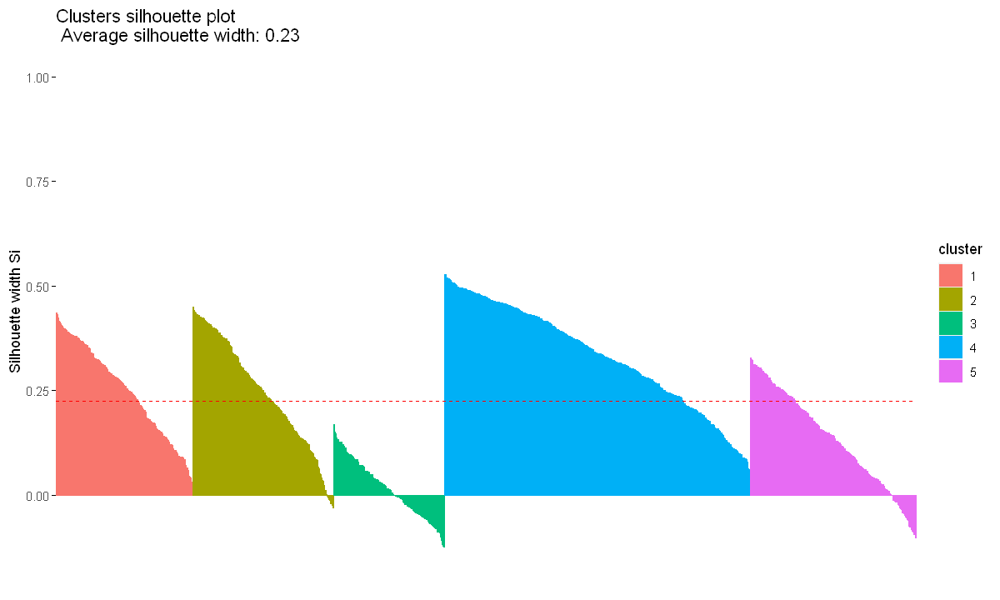

In [281]:
reskmeans = kmeans(x, centers=5,nstart=15) 
sil = silhouette(reskmeans$cluster, dist(x))
fviz_silhouette(sil)

On va garder 4 classes ce qui est en concordance avec la méthode du coude.

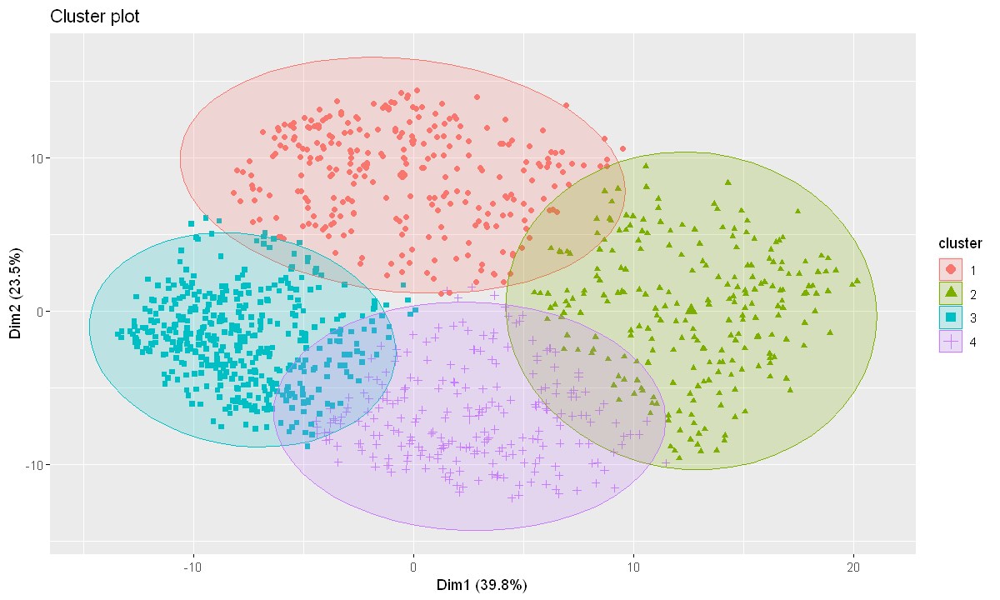

In [282]:
reskmeans_brutes = kmeans(x, centers=4,nstart=15) 

fviz_cluster(reskmeans_brutes, data=x, ellipse.type="norm", labelsize=8, geom=c("point"))



          
             1   2   3   4
  not hill 275 233 322 232
  hill       1   1 119   6

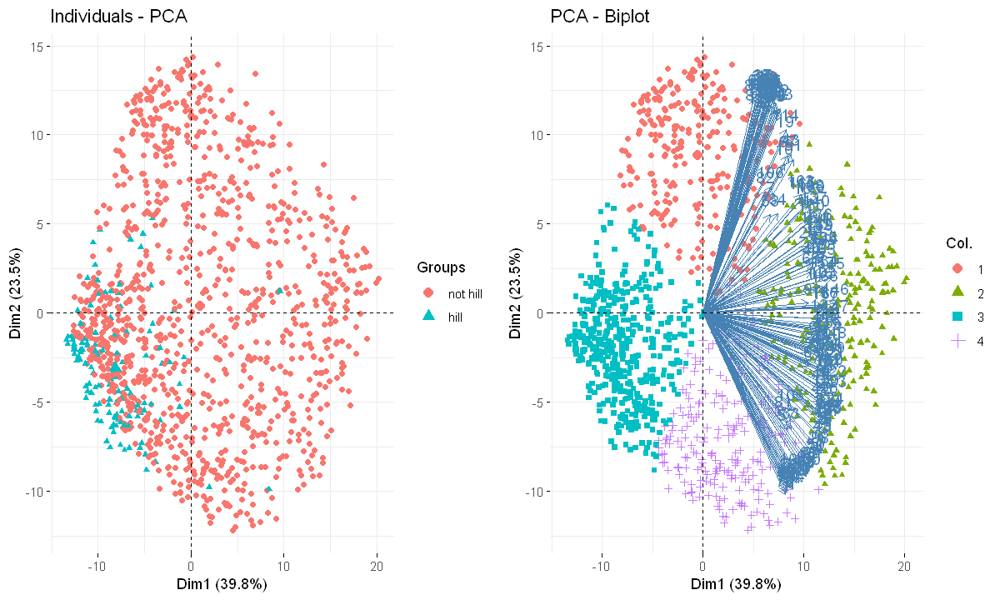

In [283]:
table(velib$bonus, reskmeans_brutes$cluster)

ggarrange(
    fviz_pca_ind(acp,axes=c(1,2), geom=c("point"), habillage=velib$bonus),
    fviz_pca(acp, col.ind=as.factor(reskmeans_brutes$cluster), geom=c("point"), axes=c(1,2))
)

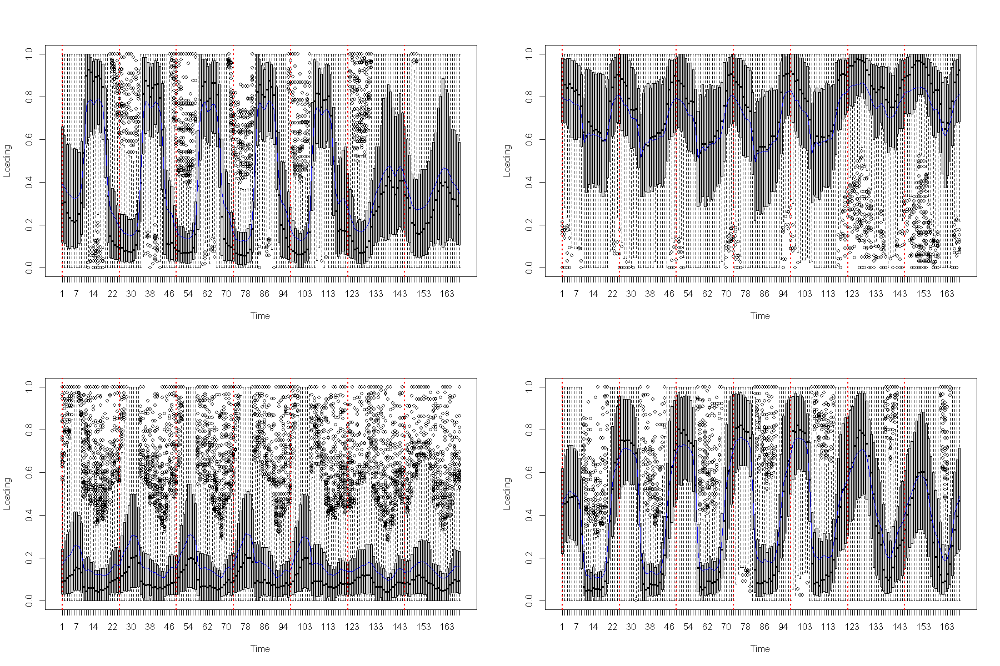

In [363]:
options(repr.plot.width = 15, repr.plot.height = 10)
par(mfrow = c(2, 2))
ind1 <- which(reskmeans_brutes$cluster == 1)
x1 <- x[ind1, ]

boxplot(x1, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_brutes$centers[1,],col="blue")
ind2 <- which(reskmeans_brutes$cluster == 2)
x2 <- x[ind2, ]

boxplot(x2, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_brutes$centers[2,],col="blue")

ind3 <- which(reskmeans_brutes$cluster == 3)
x3 <- x[ind3, ]

boxplot(x3, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_brutes$centers[3,],col="blue")
ind4 <- which(reskmeans_brutes$cluster == 4)
x4 <- x[ind4, ]

boxplot(x4, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_brutes$centers[4,],col="blue")

Comme la distribution n'est pas symétrique la médiane et la moyenne ne sont pas confondues.
Ce boxlpot est moins dispersé que celui où il y a toutes les qtations car le but du clustering est de réduire la variance intraclasse.

Le cluster du haut -> Stations + utilisées le jour que la nuit

Le cluster du bas -> Stations + utilisées la nuit que le jour

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



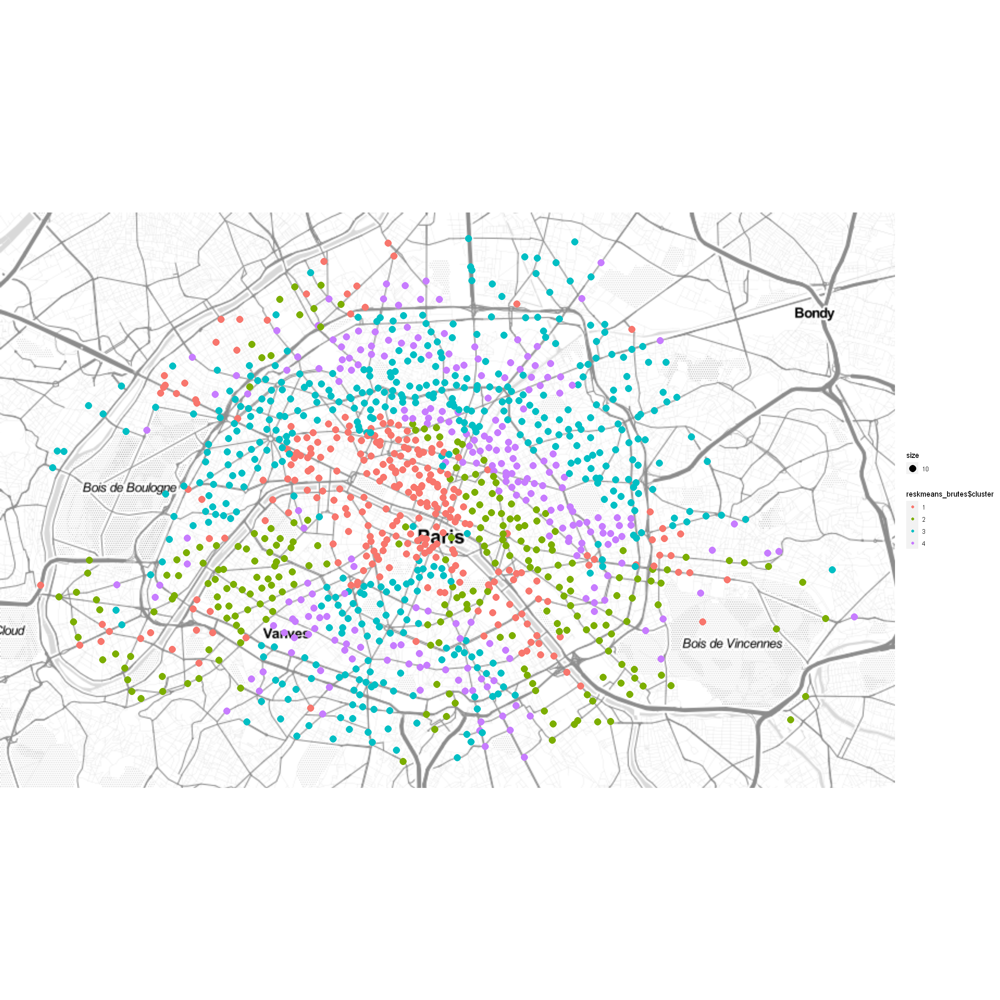

In [288]:
options(repr.plot.width = 20, repr.plot.height = 20)
reskmeans_brutes$cluster=as.factor(reskmeans_brutes$cluster)
qmplot(longitude,latitude,data=velib$position,color=reskmeans_brutes$cluster,zoom=12,size=10)

# Clustering with $k$-means sur données de l'ACP


In [289]:
#Refaire sur les coordonées de l'ACP et comparer
str(acp$ind$coord[,1:4])

 num [1:1189, 1:4] -3.047 6.479 3.12 0.659 4.443 ...
 - attr(*, "dimnames")=List of 2
  ..$ : chr [1:1189] "1" "2" "3" "4" ...
  ..$ : chr [1:4] "Dim.1" "Dim.2" "Dim.3" "Dim.4"


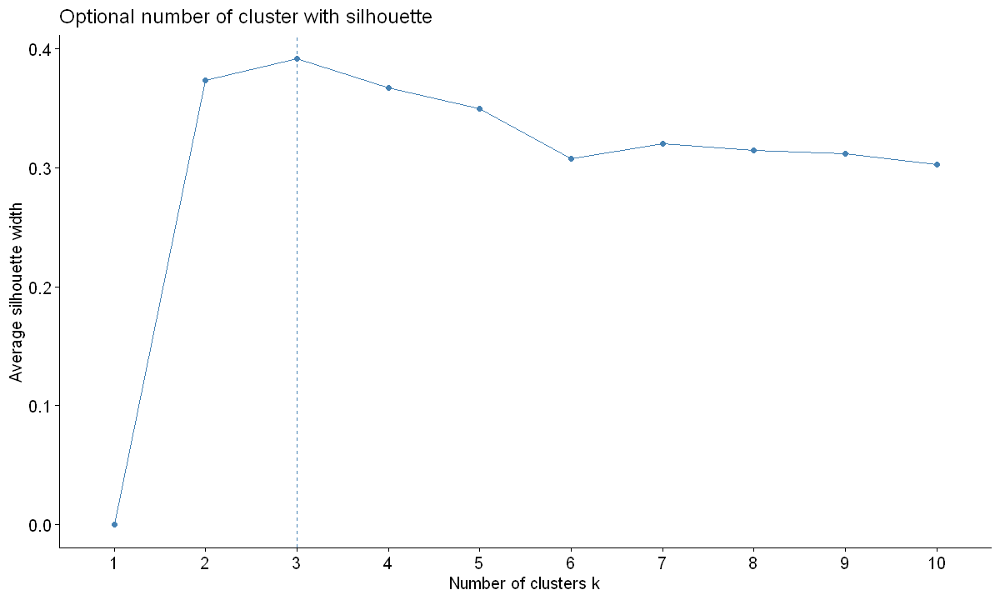

In [290]:
options(repr.plot.width = 10, repr.plot.height = 6)
fviz_nbclust(acp$ind$coord[,1:4], FUNcluster=kmeans, method="silhouette") +
    ggtitle("Optional number of cluster with silhouette")

          
             1   2   3
  not hill 367 413 282
  hill       3 122   2

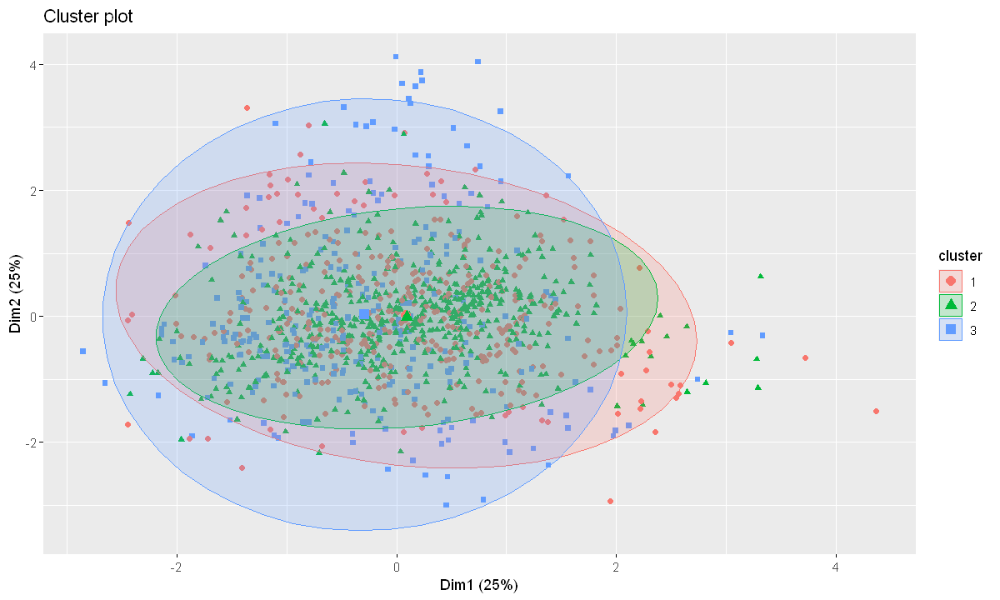

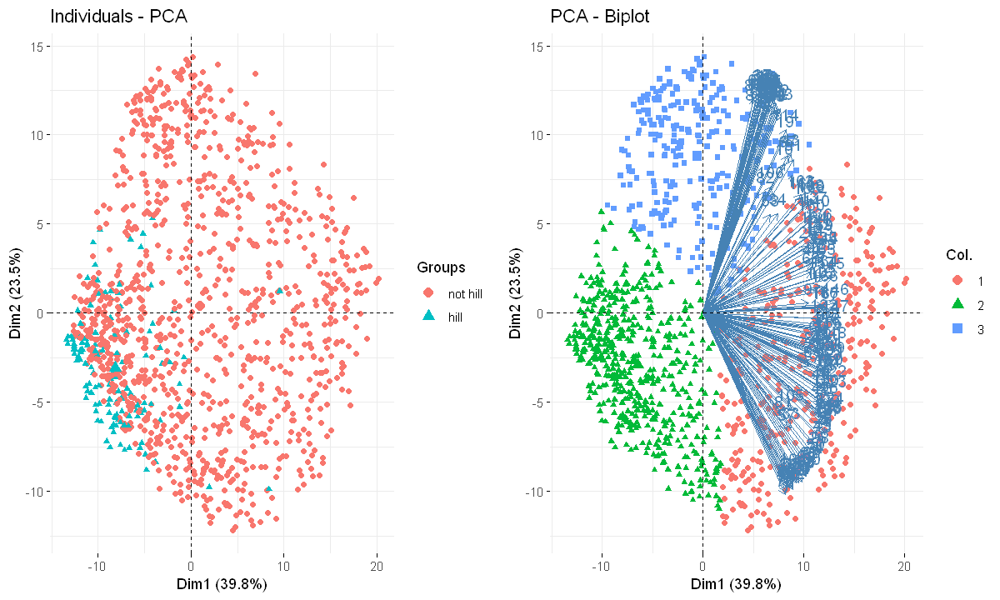

In [291]:

reskmeans3 = kmeans(acp$ind$coord[,1:4], centers=3) 

fviz_cluster(reskmeans3, data=acp$ind$coord[,1:4], ellipse.type="norm", labelsize=8, geom=c("point"))

table(velib$bonus, reskmeans3$cluster)

ggarrange(
    fviz_pca_ind(acp,axes=c(1,2), geom=c("point"), habillage=velib$bonus),
    fviz_pca(acp, col.ind=as.factor(reskmeans3$cluster), geom=c("point"), axes=c(1,2))
)

  cluster size ave.sil.width
1       1  186          0.22
2       2  218          0.25
3       3  187          0.39
4       4  151          0.40
5       5  298          0.41
6       6  149          0.12


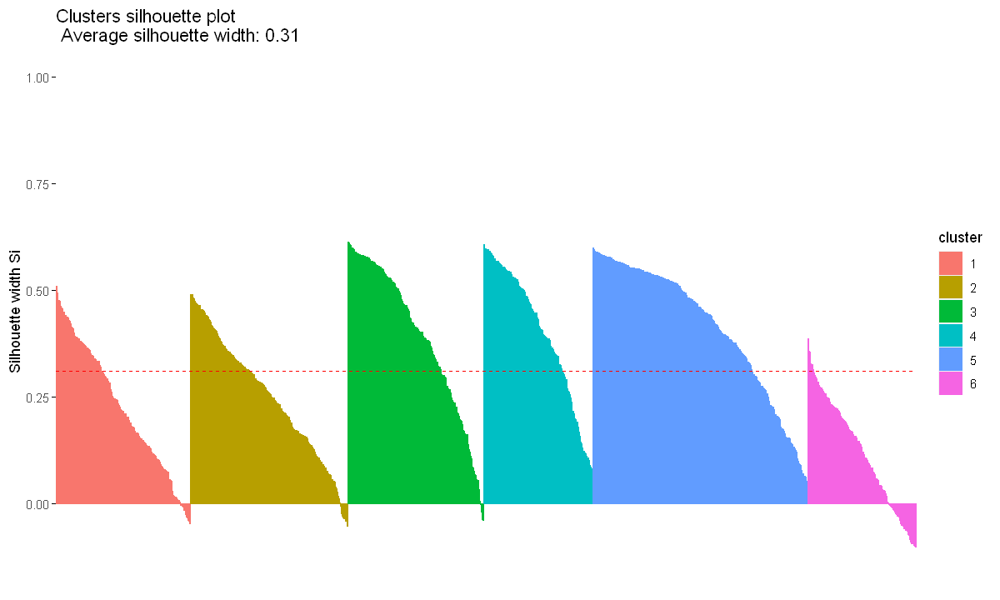

In [292]:
reskmeans_acp = kmeans(acp$ind$coord[,1:4], centers=6,nstart=15) 
sil = silhouette(reskmeans_acp$cluster, dist(acp$ind$coord[,1:4]))
fviz_silhouette(sil)

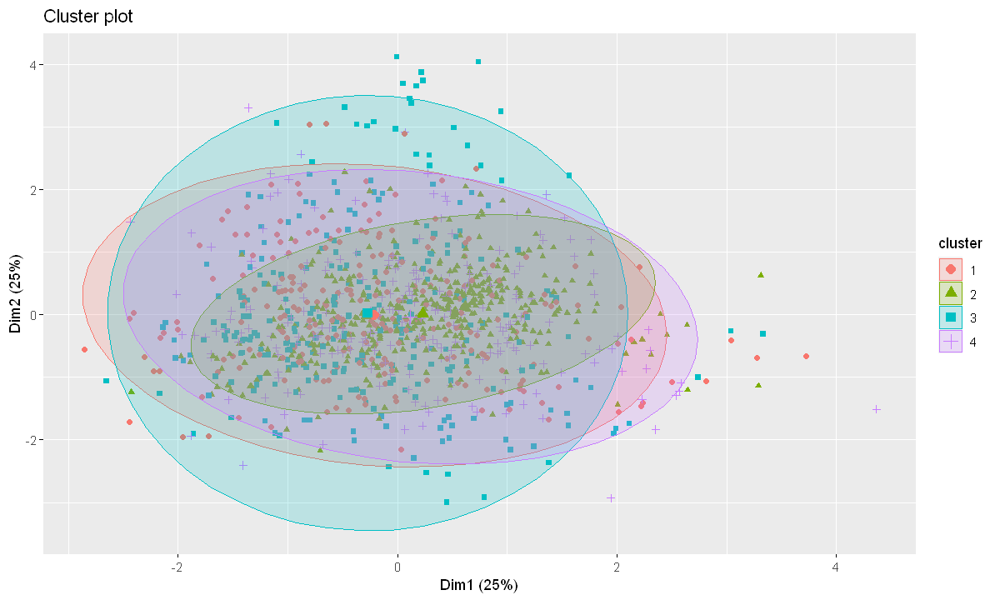

In [293]:
reskmeans_acp = kmeans(acp$ind$coord[,1:4], centers=4,nstart=15) 

fviz_cluster(reskmeans_acp, data=acp$ind$coord[,1:4], ellipse.type="norm", labelsize=8, geom=c("point"))



          
             1   2   3   4
  not hill 236 311 275 240
  hill      10 114   2   1

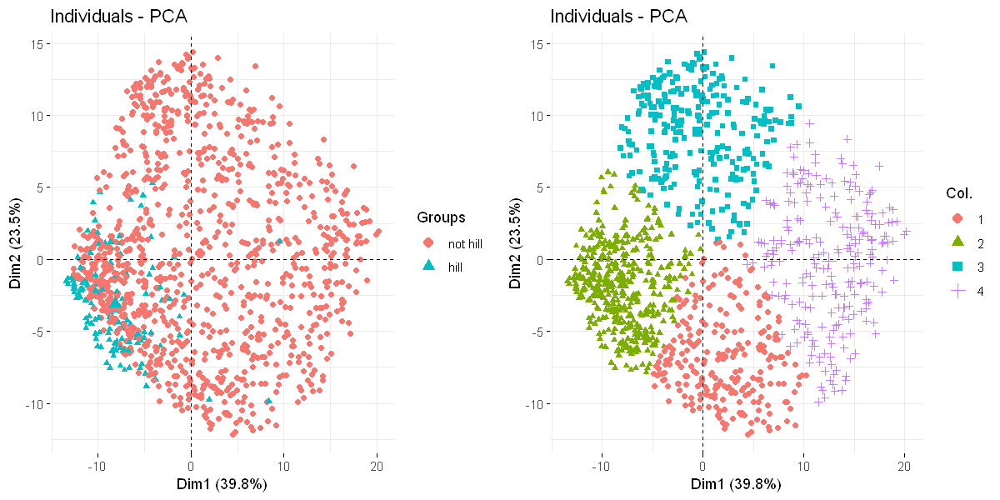

In [321]:
table(velib$bonus, reskmeans_acp$cluster)

ggarrange(
    fviz_pca_ind(acp,axes=c(1,2), geom=c("point"), habillage=velib$bonus),
    fviz_pca_ind(acp, col.ind=as.factor(reskmeans_acp$cluster), geom=c("point"), axes=c(1,2))
)

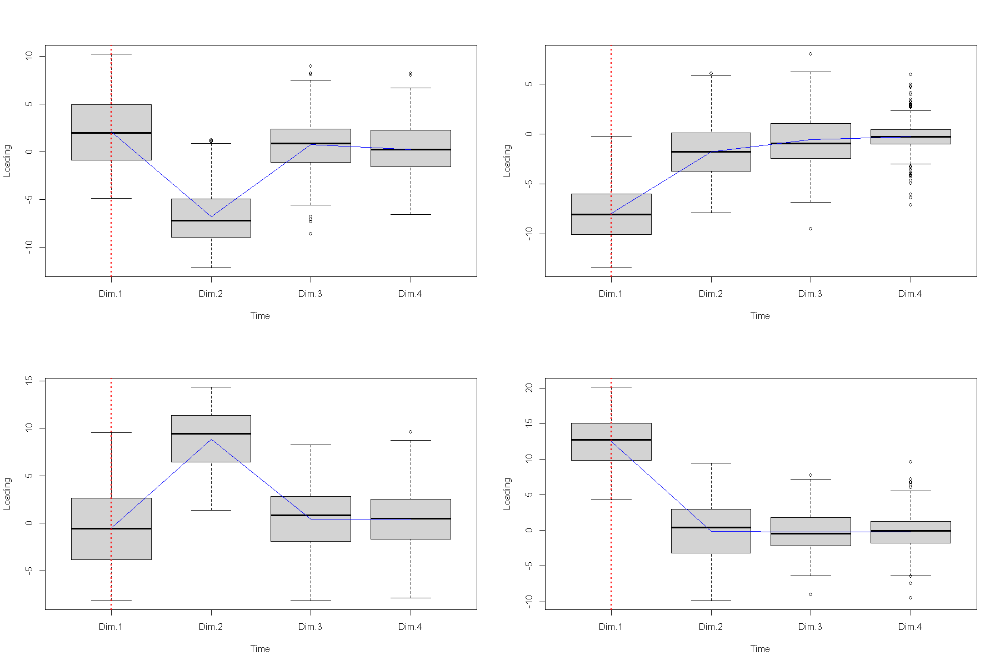

In [364]:
options(repr.plot.width = 15, repr.plot.height = 10)
par(mfrow = c(2, 2))
ind1 <- which(reskmeans_acp$cluster == 1)
x1 <- acp$ind$coord[,1:4][ind1, ]

boxplot(x1, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[1,],col="blue")

ind2 <- which(reskmeans_acp$cluster == 2)
x2 <- acp$ind$coord[,1:4][ind2, ]

boxplot(x2, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[2,],col="blue")
ind3 <- which(reskmeans_acp$cluster == 3)
x3 <- acp$ind$coord[,1:4][ind3, ]

boxplot(x3, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[3,],col="blue")
ind4 <- which(reskmeans_acp$cluster == 4)
x4 <- acp$ind$coord[,1:4][ind4, ]

boxplot(x4, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[4,],col="blue")

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



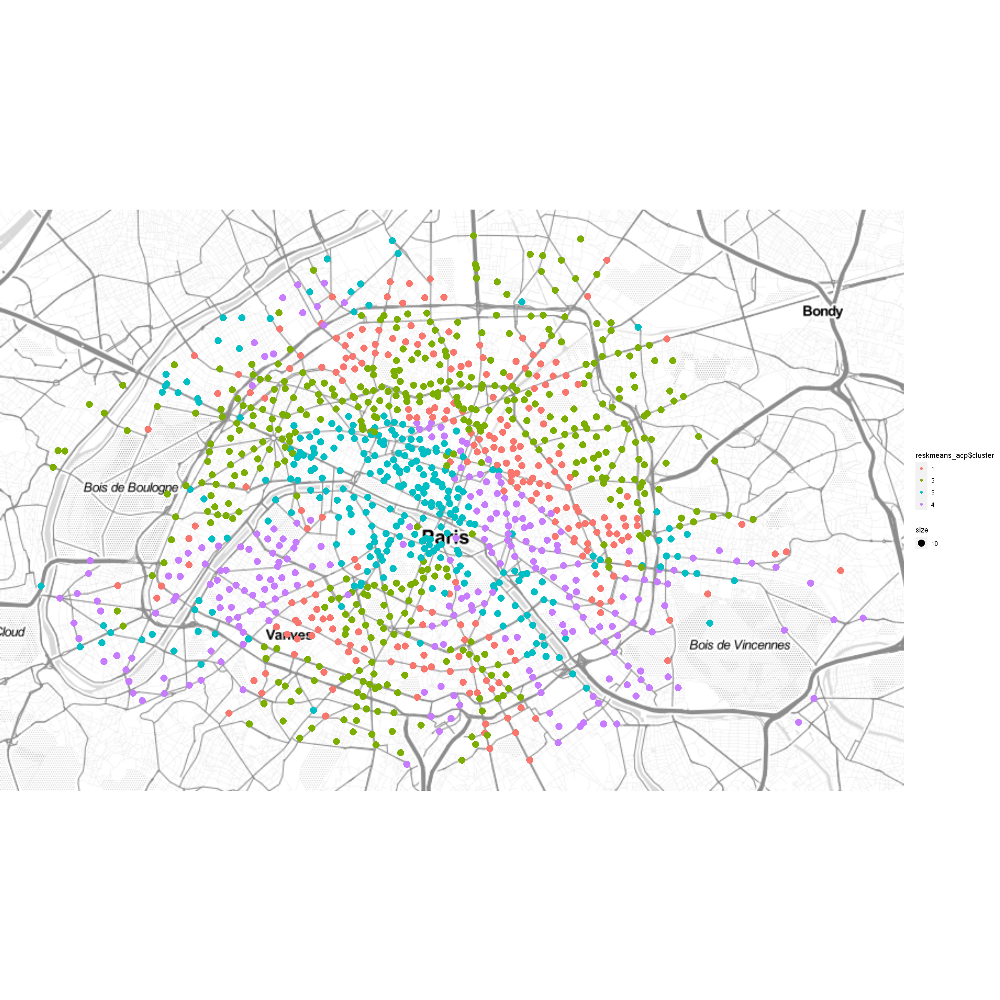

In [299]:
options(repr.plot.width = 20, repr.plot.height = 20)
reskmeans_acp$cluster=as.factor(reskmeans_acp$cluster)
qmplot(longitude,latitude,data=velib$position,color=reskmeans_acp$cluster,zoom=12,size=10)

# Comparaison données brutes / données ACP

In [300]:
install.packages("cluster")

Warning message:
"le package 'cluster' est en cours d'utilisation et ne sera pas installé"


In [301]:
library(cluster)

# Définir les ensembles de clusters générés par les deux algorithmes

# Calculer l'indice de Rand
rand_index <- adjustedRandIndex(reskmeans_acp$cluster, reskmeans_brutes$cluster)

# Afficher le résultat
print(rand_index)

[1] 0.9382258


L'indice Rand est proche de 95%, les deux classifications proposées sur les données brutes et celles de l'acp sont à 95% similaires. ON peut donc garder la classification sur les données de l'acp puisque celles-ci réduisent considérablement le nombre de dim.

**Results of the Correspondence Analysis (CA)**
The row variable has  4  categories; the column variable has 4 categories
The chi square of independence between the two variables is equal to 3333.223 (p-value =  0 ).
*The results are available in the following objects:

   name              description                   
1  "$eig"            "eigenvalues"                 
2  "$col"            "results for the columns"     
3  "$col$coord"      "coord. for the columns"      
4  "$col$cos2"       "cos2 for the columns"        
5  "$col$contrib"    "contributions of the columns"
6  "$row"            "results for the rows"        
7  "$row$coord"      "coord. for the rows"         
8  "$row$cos2"       "cos2 for the rows"           
9  "$row$contrib"    "contributions of the rows"   
10 "$call"           "summary called parameters"   
11 "$call$marge.col" "weights of the columns"      
12 "$call$marge.row" "weights of the rows"         

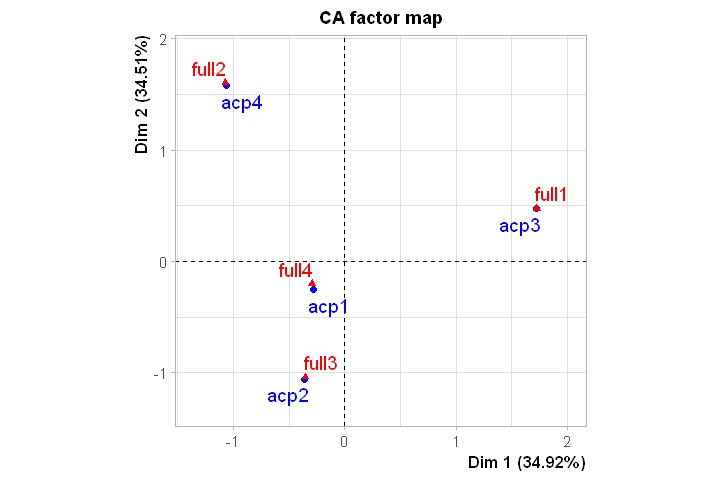

In [367]:
options(repr.plot.width = 6, repr.plot.height = 4)
tab=table(reskmeans_acp$cluster, reskmeans_brutes$cluster)
rownames(tab) <- paste("acp", 1:4, sep = "")
colnames(tab) <- paste("full", 1:4, sep = "")

ca <- CA(tab)
ca

# Clustering with CAH sur données brutes


In [303]:
d = dist(x, method="euclidean")

hclustsingle_brutes = hclust(d, method="single")
hclustcomplete_brutes = hclust(d, method="complete")
hclustaverage_brutes = hclust(d, method="average")


options(repr.plot.width=10, repr.plot.height=10)




In [304]:

fviz_dend(hclustsingle_brutes, show_labels=FALSE)

Warning message:
"The `<scale>` argument of `guides()` cannot be `FALSE`. Use "none" instead as of ggplot2 3.3.4.
ℹ The deprecated feature was likely used in the factoextra package.
  Please report the issue at <https://github.com/kassambara/factoextra/issues>."


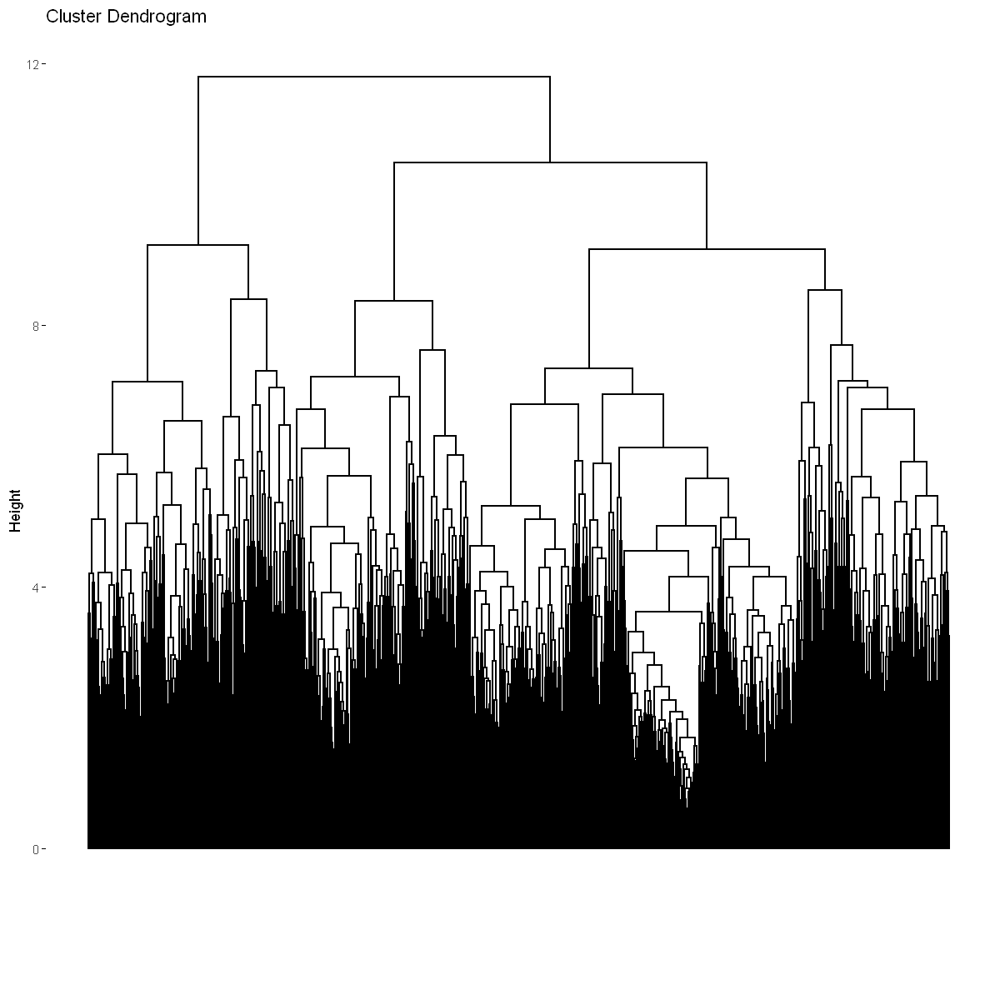

In [305]:

fviz_dend(hclustcomplete_brutes, show_labels=FALSE)

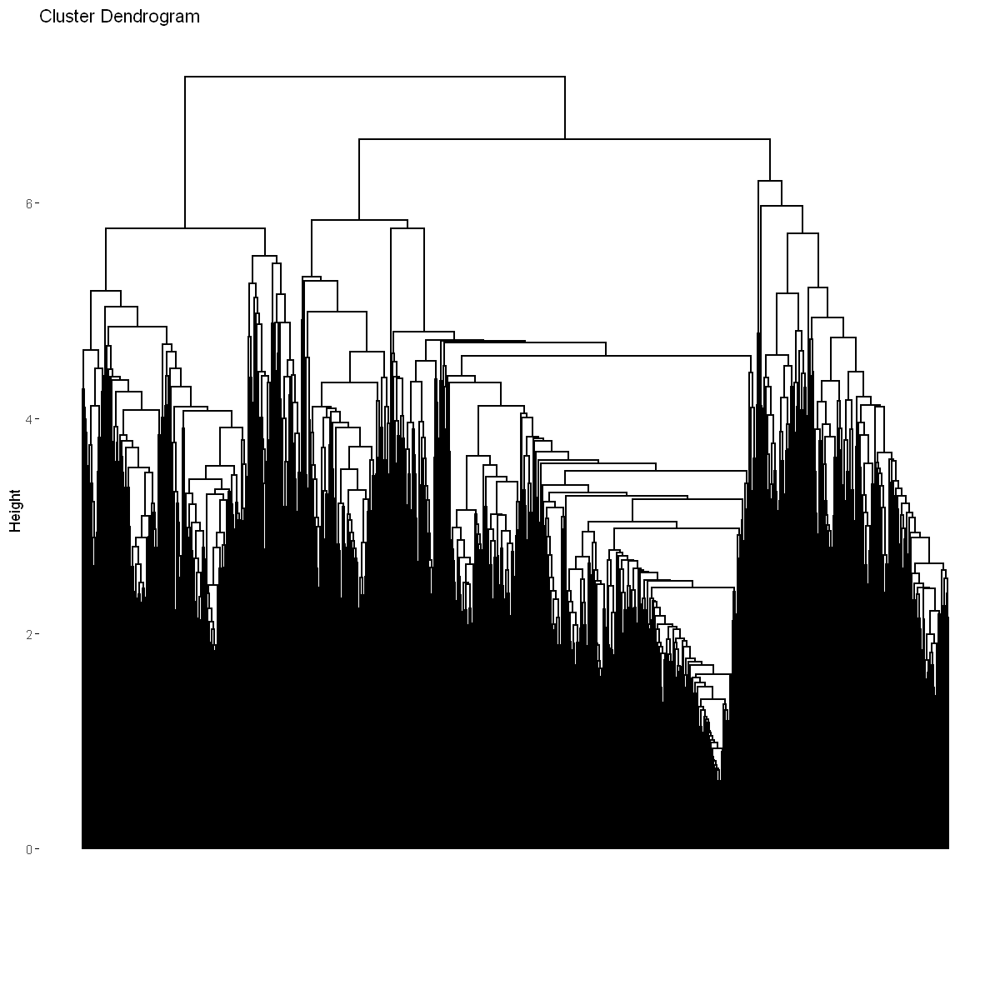

In [306]:

fviz_dend(hclustaverage_brutes, show_labels=FALSE)

In [307]:
ClassK4_brutes = cutree(hclustcomplete_brutes, 4)

              
ClassK4_brutes not hill hill
             1      539  124
             2      240    2
             3      109    1
             4      174    0

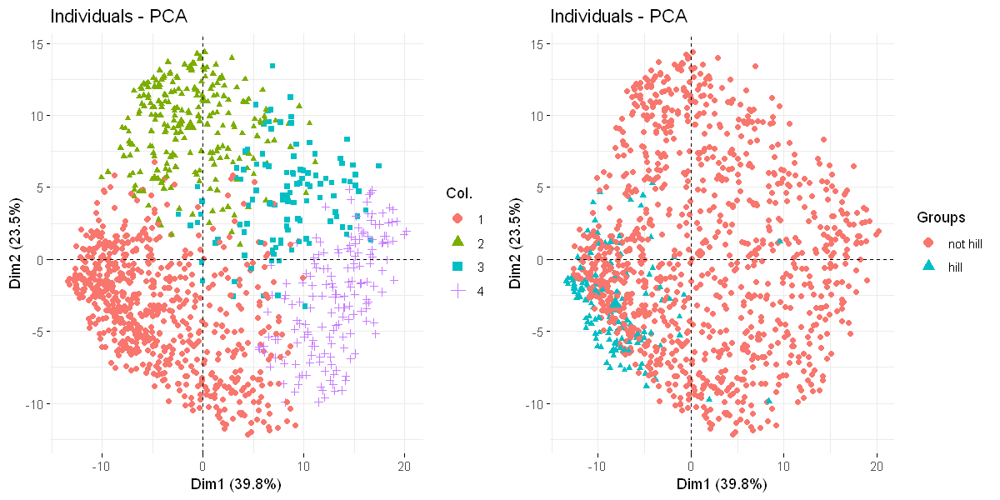

In [320]:
table(ClassK4_brutes, velib$bonus)

# --- #

options(repr.plot.width = 10, repr.plot.height =5)

ggarrange(
    fviz_pca_ind(acp, col.ind=as.factor(ClassK4_brutes), geom=c("point"), axes=c(1,2)),
    fviz_pca_ind(acp, axes=c(1,2), geom=c("point"), habillage=velib$bonus)

)

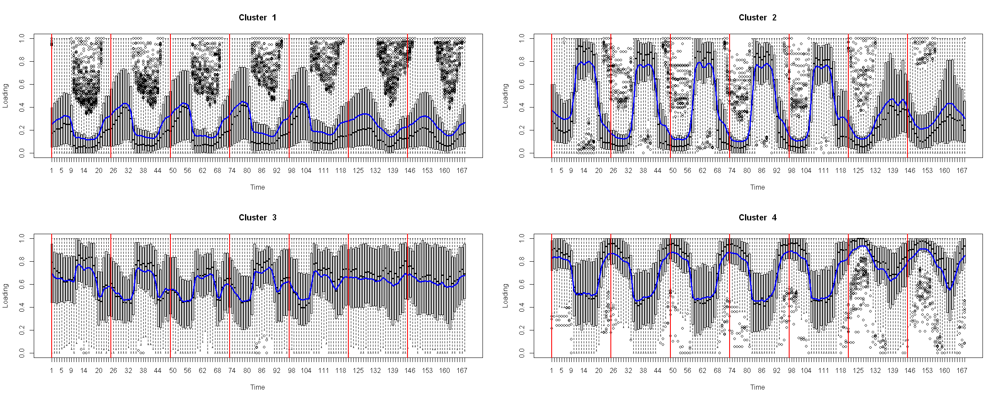

In [327]:
par(mfrow=c(2,2))
options(repr.plot.width=20,repr.plot.height=8)
for (i in 1:4){
    boxplot(x[which(ClassK4_brutes==i),],
            xlab="Time",ylab="Loading",main=paste("Cluster ",i))
    lines(colMeans(x[which(ClassK4_brutes==i),]),col="blue",lwd=3)
    abline(v=timeTick, col = "red", lwd=2)
}

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



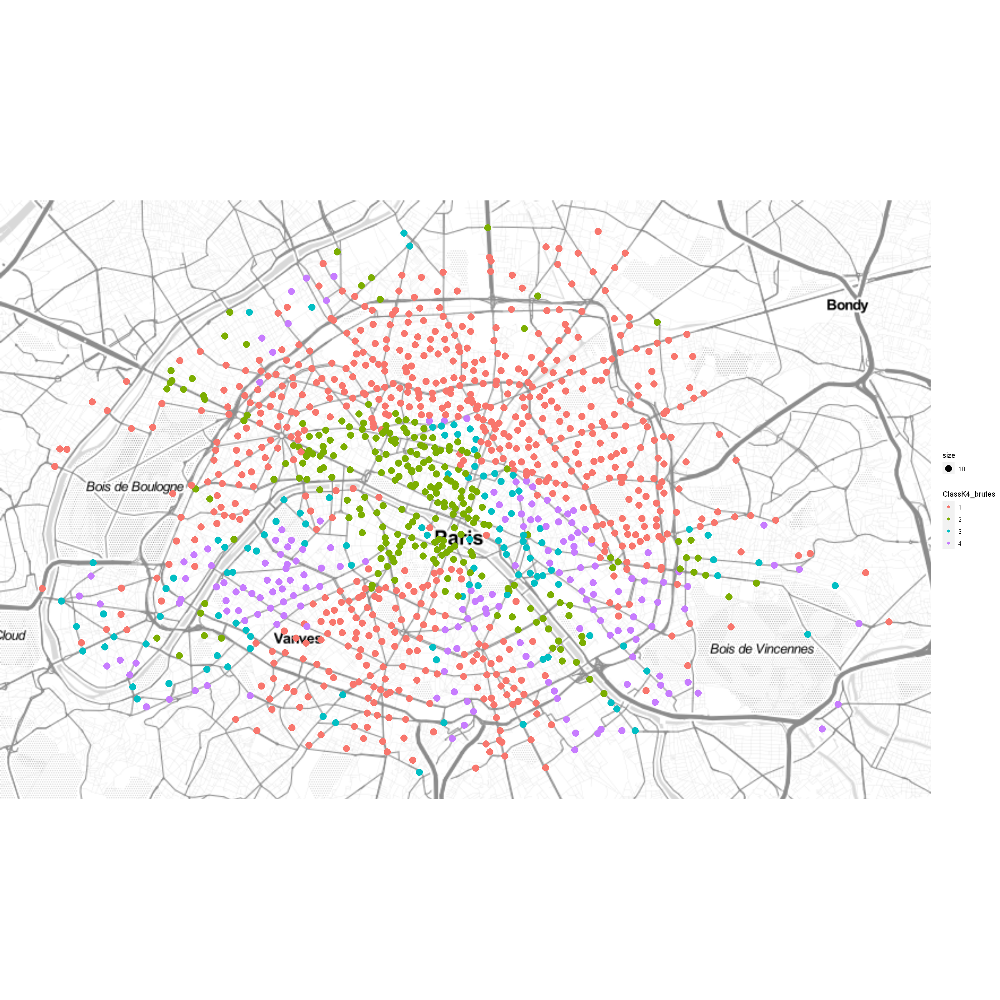

In [309]:
options(repr.plot.width = 20, repr.plot.height = 20)
ClassK4_brutes=as.factor(ClassK4_brutes)
qmplot(longitude,latitude,data=velib$position,color=ClassK4_brutes,zoom=12,size=10)

# Clustering with CAH sur données acp

In [310]:
d = dist(acp$ind$coord[,1:4], method="euclidean")

hclustsingle = hclust(d, method="single")
hclustcomplete = hclust(d, method="complete")
hclustaverage = hclust(d, method="average")


options(repr.plot.width=10, repr.plot.height=10)




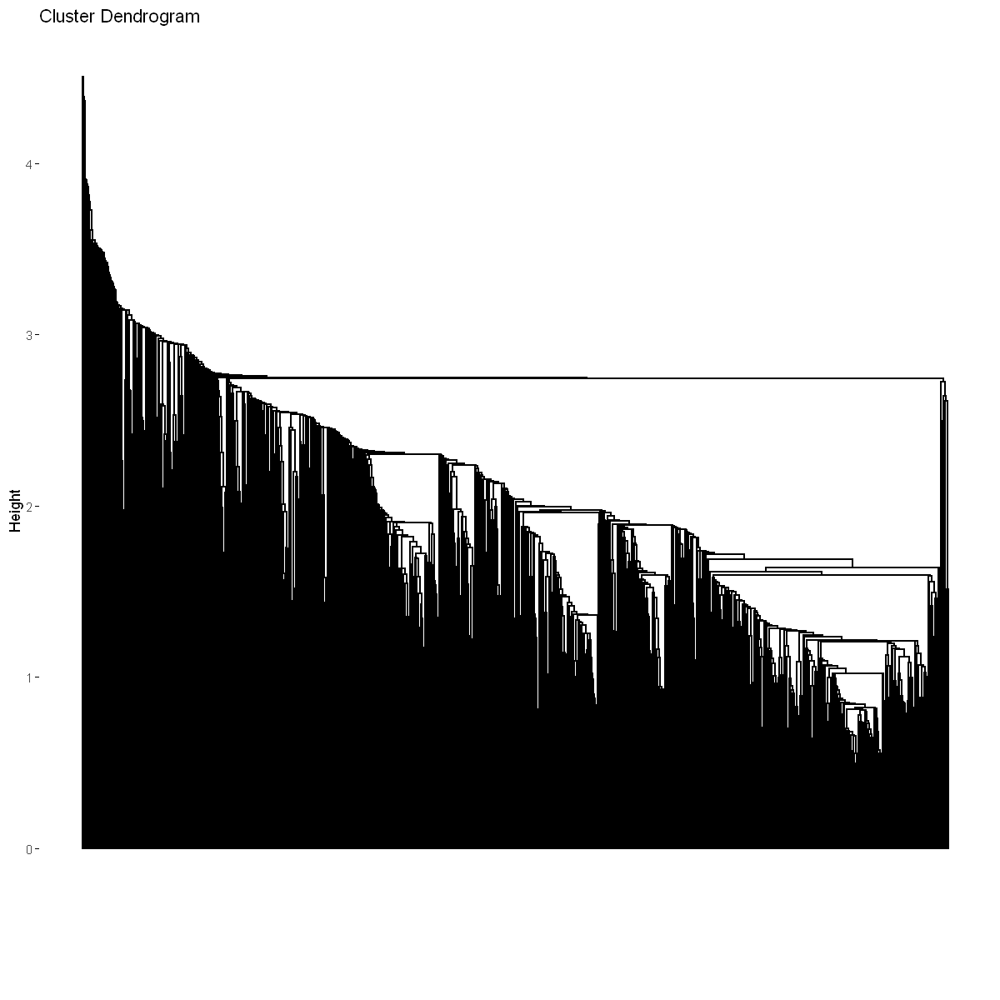

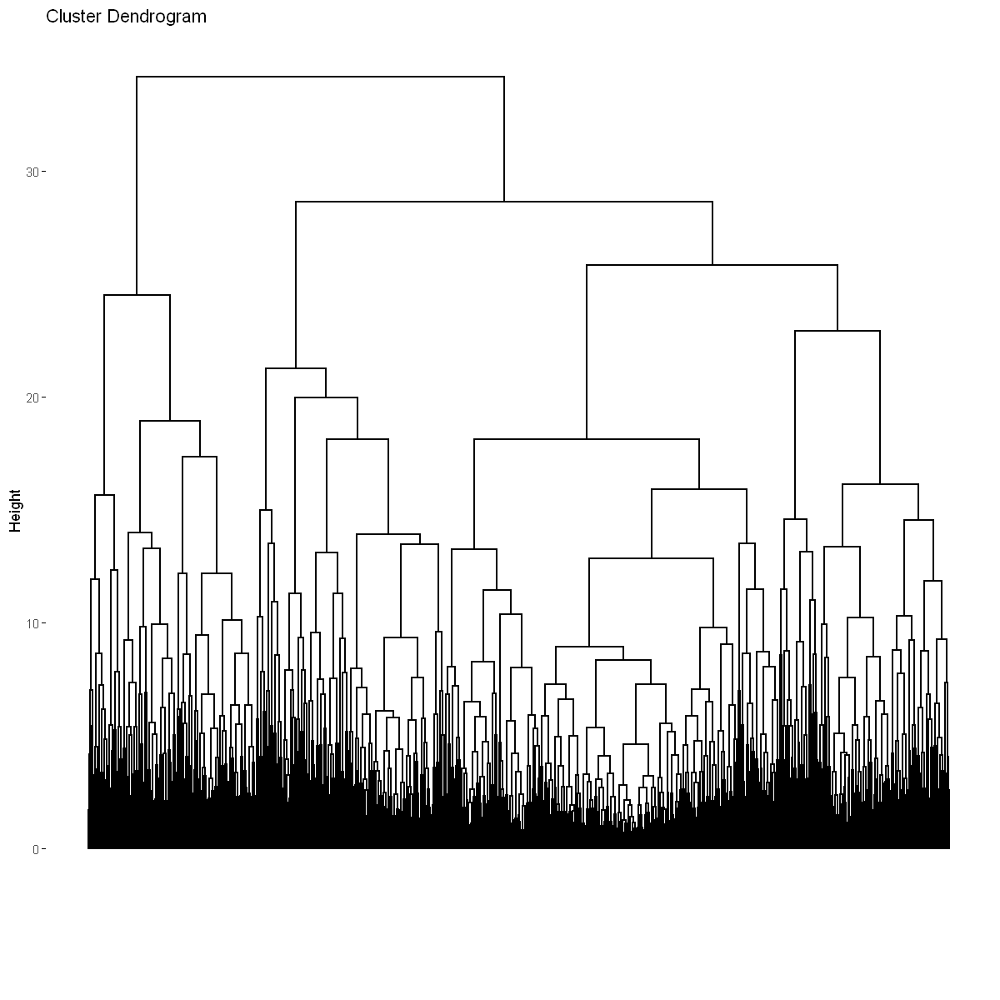

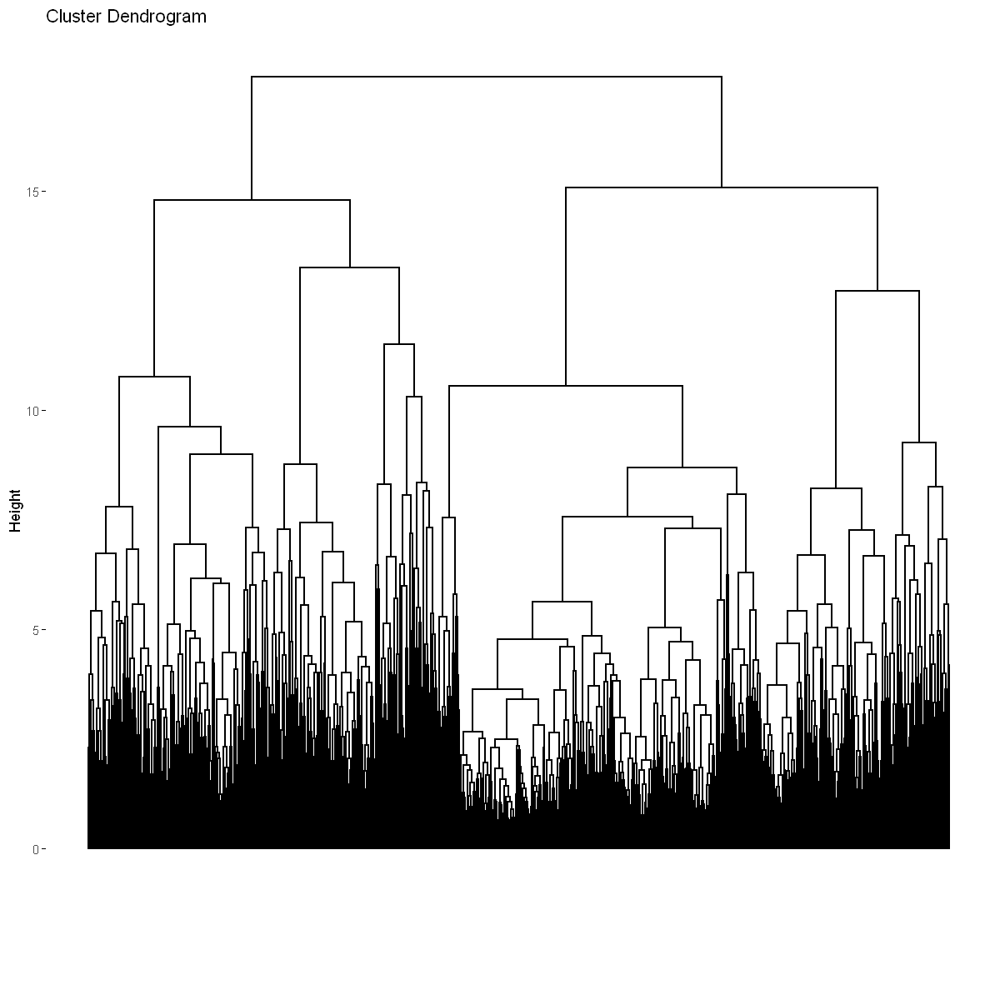

In [311]:

fviz_dend(hclustsingle, show_labels=FALSE)
fviz_dend(hclustcomplete, show_labels=FALSE)
fviz_dend(hclustaverage, show_labels=FALSE)

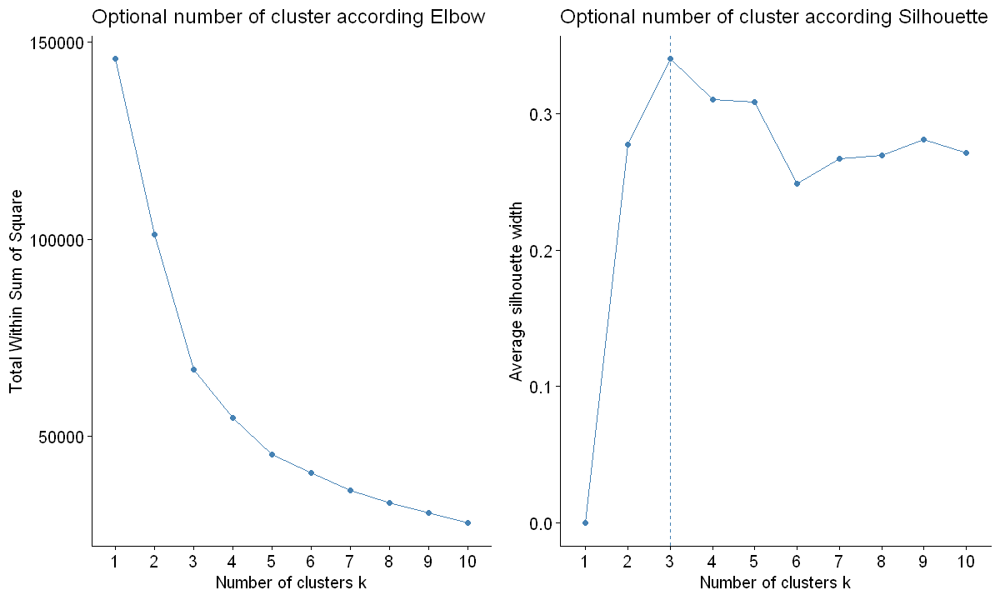

In [312]:
options(repr.plot.width = 10, repr.plot.height = 6)

ggarrange(
    fviz_nbclust(acp$ind$coord[,1:4], FUNcluster=hcut, method="wss") + ggtitle("Optional number of cluster according Elbow"),
    fviz_nbclust(acp$ind$coord[,1:4], FUNcluster=hcut, method="silhouette") + ggtitle("Optional number of cluster according Silhouette")
)

In [347]:
ClassK4_acp = cutree(hclustcomplete, 4)

           
ClassK4_acp not hill hill
          1      344  118
          2      229    6
          3      258    2
          4      231    1

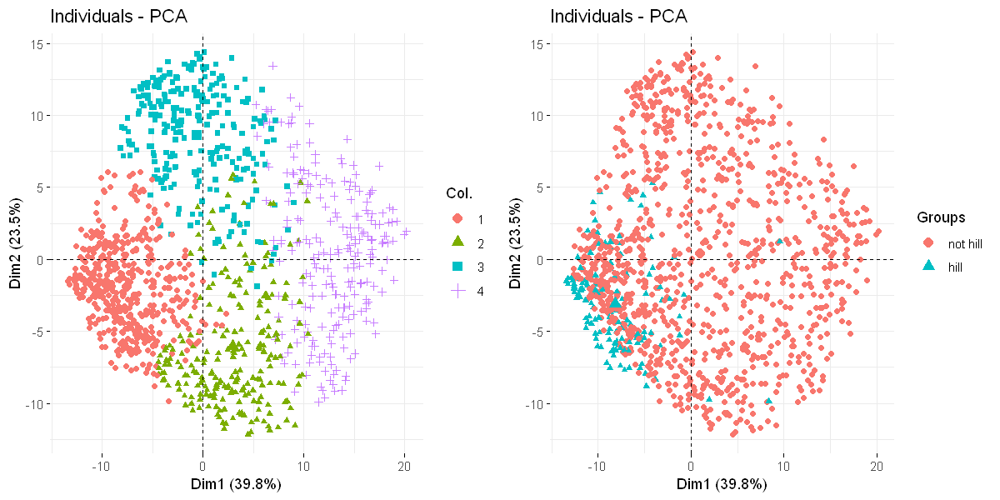

In [318]:
table(ClassK4_acp, velib$bonus)

# --- #

options(repr.plot.width = 10, repr.plot.height =5)

ggarrange(
    fviz_pca_ind(acp, col.ind=as.factor(ClassK4_acp), geom=c("point"), axes=c(1,2)),
    fviz_pca_ind(acp, axes=c(1,2), geom=c("point"), habillage=velib$bonus)

)

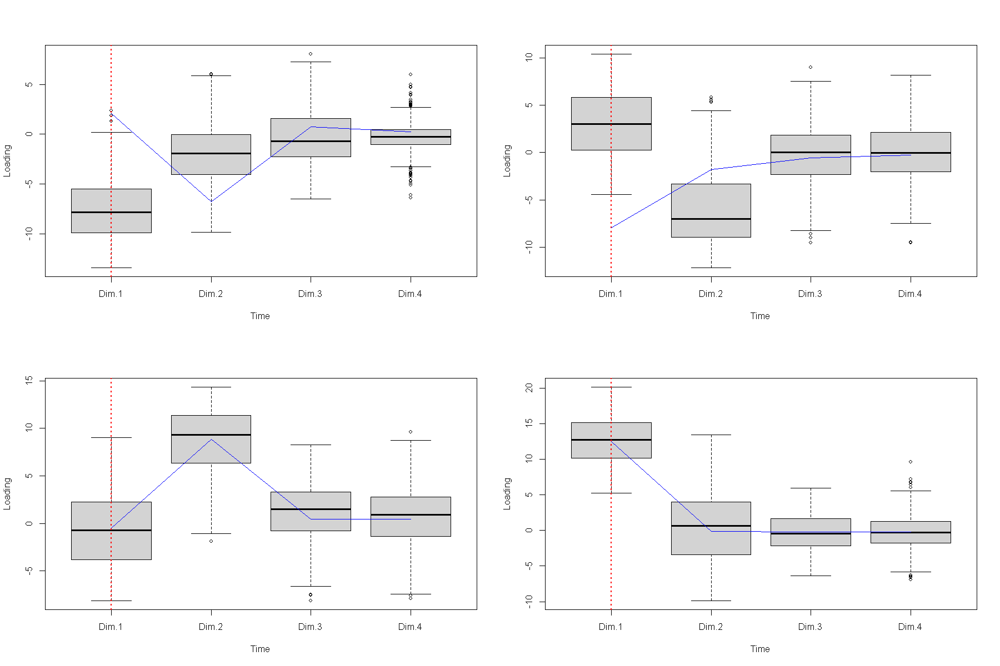

In [371]:
options(repr.plot.width = 15, repr.plot.height = 10)
par(mfrow = c(2, 2))
ind1 <- which(ClassK4_acp== 1)
x1 <- acp$ind$coord[,1:4][ind1, ]

boxplot(x1, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[1,],col="blue")

ind2 <- which(ClassK4_acp == 2)
x2 <- acp$ind$coord[,1:4][ind2, ]

boxplot(x2, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[2,],col="blue")
ind3 <- which(ClassK4_acp == 3)
x3 <- acp$ind$coord[,1:4][ind3, ]

boxplot(x3, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[3,],col="blue")
ind4 <- which(ClassK4_acp == 4)
x4 <- acp$ind$coord[,1:4][ind4, ]

boxplot(x4, xlab="Time",ylab="Loading")
abline(v=timeTick,lty="dotted", col="red",lwd=2)
lines(reskmeans_acp$centers[4,],col="blue")

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



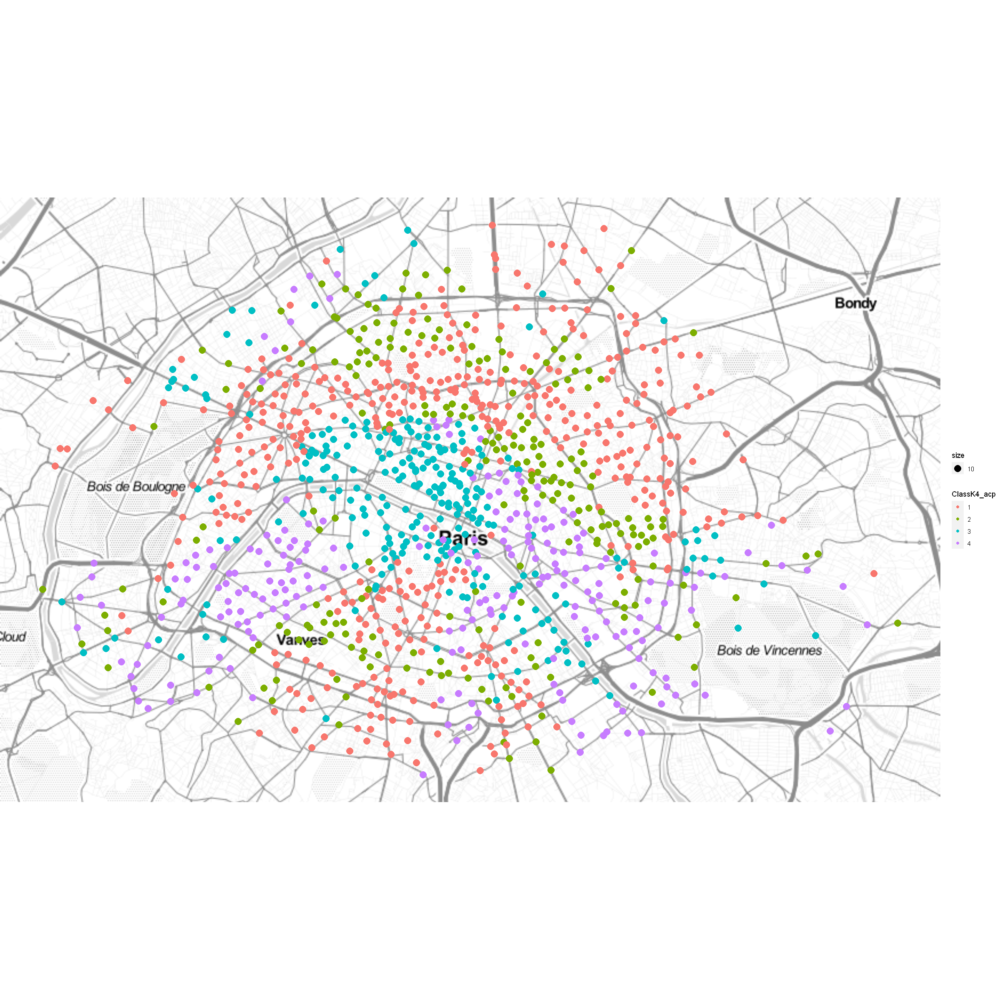

In [315]:
options(repr.plot.width = 20, repr.plot.height = 20)
ClassK4_acp=as.factor(ClassK4_acp)
qmplot(longitude,latitude,data=velib$position,color=ClassK4_acp,zoom=12,size=10)

**Results of the Correspondence Analysis (CA)**
The row variable has  4  categories; the column variable has 4 categories
The chi square of independence between the two variables is equal to 1729.54 (p-value =  0 ).
*The results are available in the following objects:

   name              description                   
1  "$eig"            "eigenvalues"                 
2  "$col"            "results for the columns"     
3  "$col$coord"      "coord. for the columns"      
4  "$col$cos2"       "cos2 for the columns"        
5  "$col$contrib"    "contributions of the columns"
6  "$row"            "results for the rows"        
7  "$row$coord"      "coord. for the rows"         
8  "$row$cos2"       "cos2 for the rows"           
9  "$row$contrib"    "contributions of the rows"   
10 "$call"           "summary called parameters"   
11 "$call$marge.col" "weights of the columns"      
12 "$call$marge.row" "weights of the rows"         

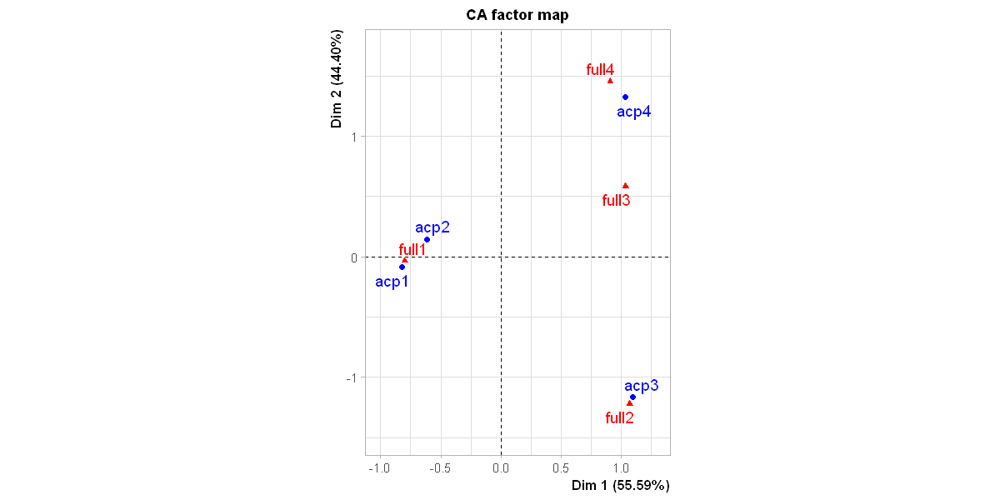

In [370]:
options(repr.plot.width = 10, repr.plot.height = 5
       )
tab=table(ClassK4_acp,ClassK4_brutes)
rownames(tab) <- paste("acp", 1:4, sep = "")
colnames(tab) <- paste("full", 1:4, sep = "")

ca <- CA(tab)
ca

In [71]:

rand_index_cah <- adjustedRandIndex(ClassK4_acp, ClassK4_brutes)

# Afficher le résultat
print(rand_index_cah)

[1] 0.5283379


Il n'y a pas une excellente concordance entre le CAH sur données brutes et sur données de l'acp. Cependant, on réduit tout de même le nombre de variable de plus de 160

## Clustering with Gaussian Mixture sur données de l'acp

---------------------------------------------------- 
Gaussian finite mixture model fitted by EM algorithm 
---------------------------------------------------- 

Mclust VVE (ellipsoidal, equal orientation) model with 12 components: 

 log-likelihood    n  df       BIC       ICL
       -12633.1 1189 113 -26066.35 -26520.26

Clustering table:
  1   2   3   4   5   6   7   8   9  10  11  12 
131 170  54  84  56  83 107 129 101 124  70  80 

Warning message:
"`gather_()` was deprecated in tidyr 1.2.0.
ℹ Please use `gather()` instead.
ℹ The deprecated feature was likely used in the factoextra package.
  Please report the issue at <https://github.com/kassambara/factoextra/issues>."


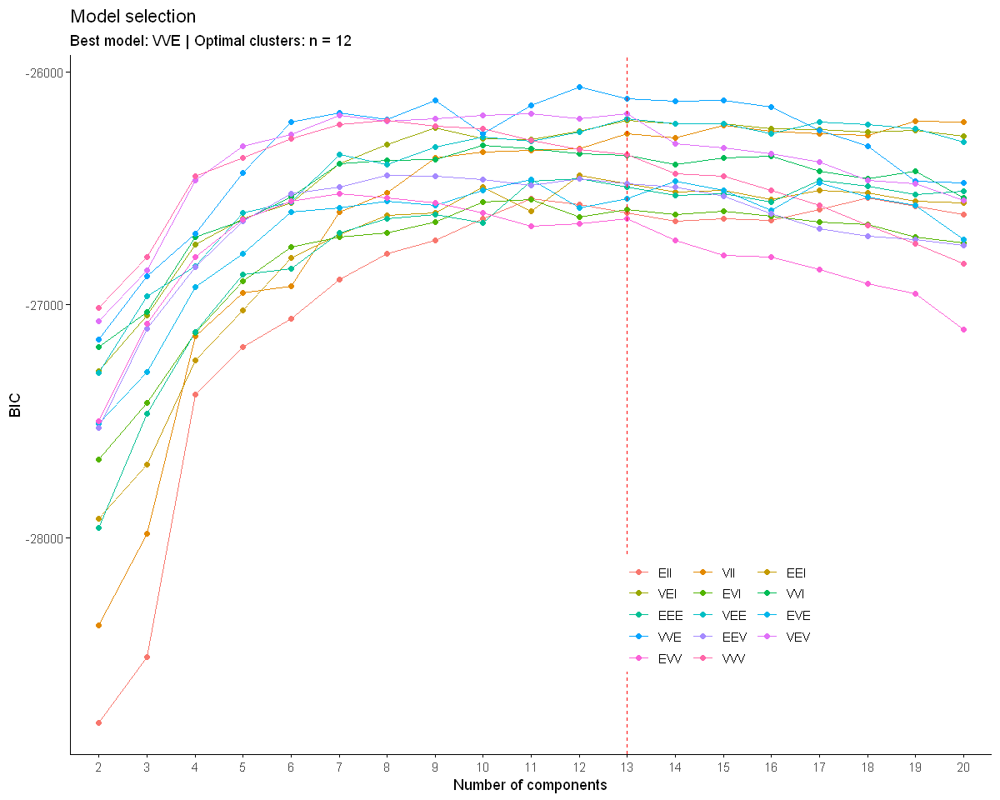

In [329]:
resBICall = Mclust(acp$ind$coord[,1:4], G=2:20)
summary(resBICall)
fviz_mclust(resBICall, what="BIC")

On sélectionne G=12

ERROR while rich displaying an object: Error in `geom_boxplot()`:
! Problem while setting up geom aesthetics.
ℹ Error occurred in the 1st layer.
Caused by error in `check_aesthetics()`:
! Aesthetics must be either length 1 or the same as the data (12)
✖ Fix the following mappings: `colour` and `fill`

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj

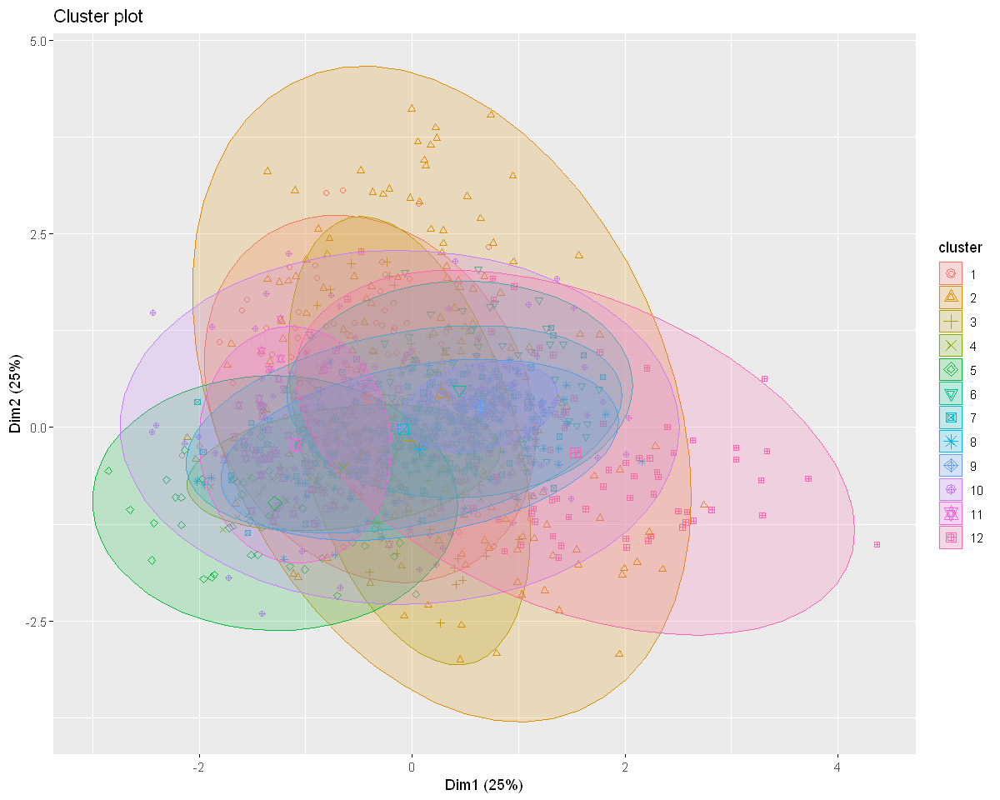

In [335]:
resBIC = Mclust(acp$ind$coord[,1:4], G=12, modelNames = "VVE")
#9 classes c'est bcp, le BIC continue d'overfiter  même avec un critère de pénalisation 
fviz_cluster(resBIC, data=acp$ind$coord[,1:4], ellipse.type="norm", geom="point")

# --- #

aux = data.frame(
    label = paste("Cluster", resBIC$classification, sep=""), 
    proba = apply(resBIC$z, 1, max))

ggplot(aux, aes(x=label, y=proba)) + 
    geom_boxplot(colour=1:9, fill=1:9, alpha=.4)

           
ClassK4_acp not hill hill
          1      344  118
          2      229    6
          3      258    2
          4      231    1

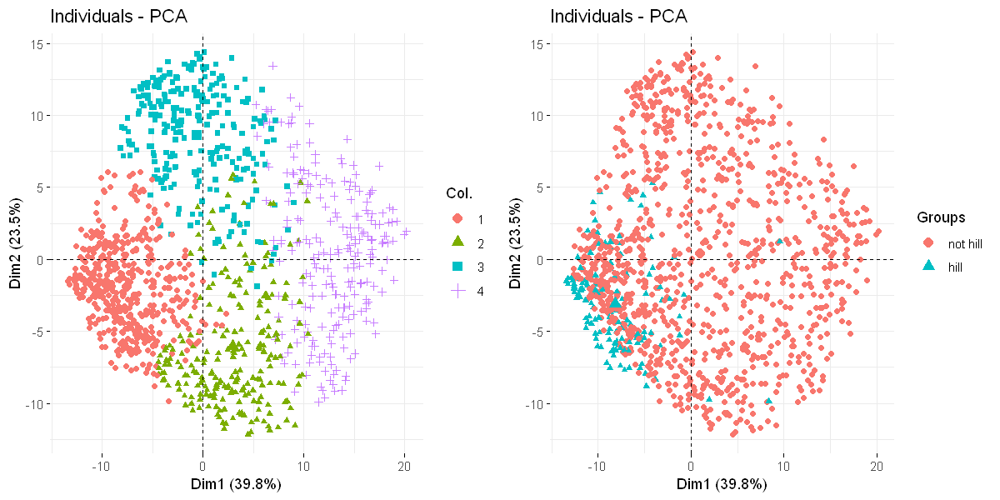

In [341]:
table(ClassK4_acp, velib$bonus)

# --- #

options(repr.plot.width = 10, repr.plot.height =5)

ggarrange(
    fviz_pca_ind(acp, col.ind=as.factor(ClassK4_acp), geom=c("point"), axes=c(1,2)),
    fviz_pca_ind(acp, axes=c(1,2), geom=c("point"), habillage=velib$bonus)

)

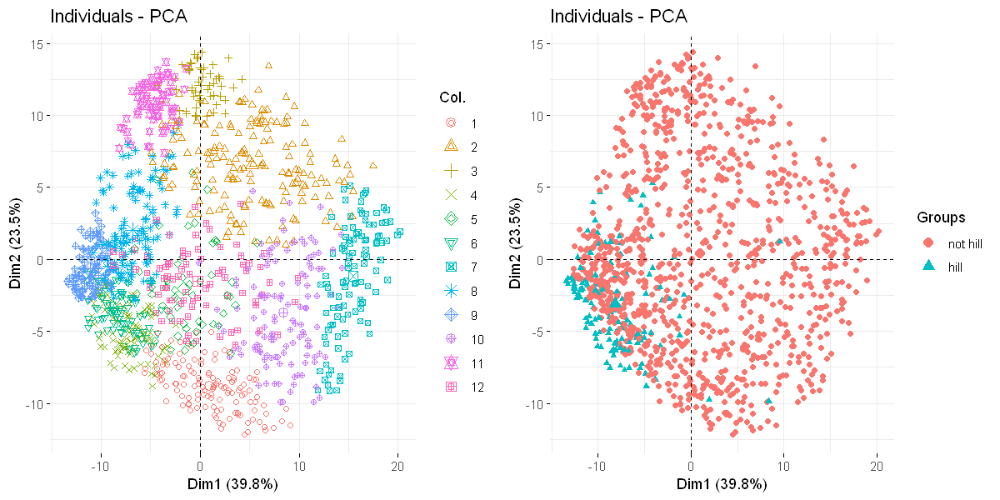

In [344]:

options(repr.plot.width = 10, repr.plot.height =5)

ggarrange(
    fviz_pca_ind(acp, col.ind=as.factor(resBIC$classification), geom=c("point"), axes=c(1,2)),
    fviz_pca_ind(acp, axes=c(1,2), geom=c("point"), habillage=velib$bonus)

)

ℹ Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.



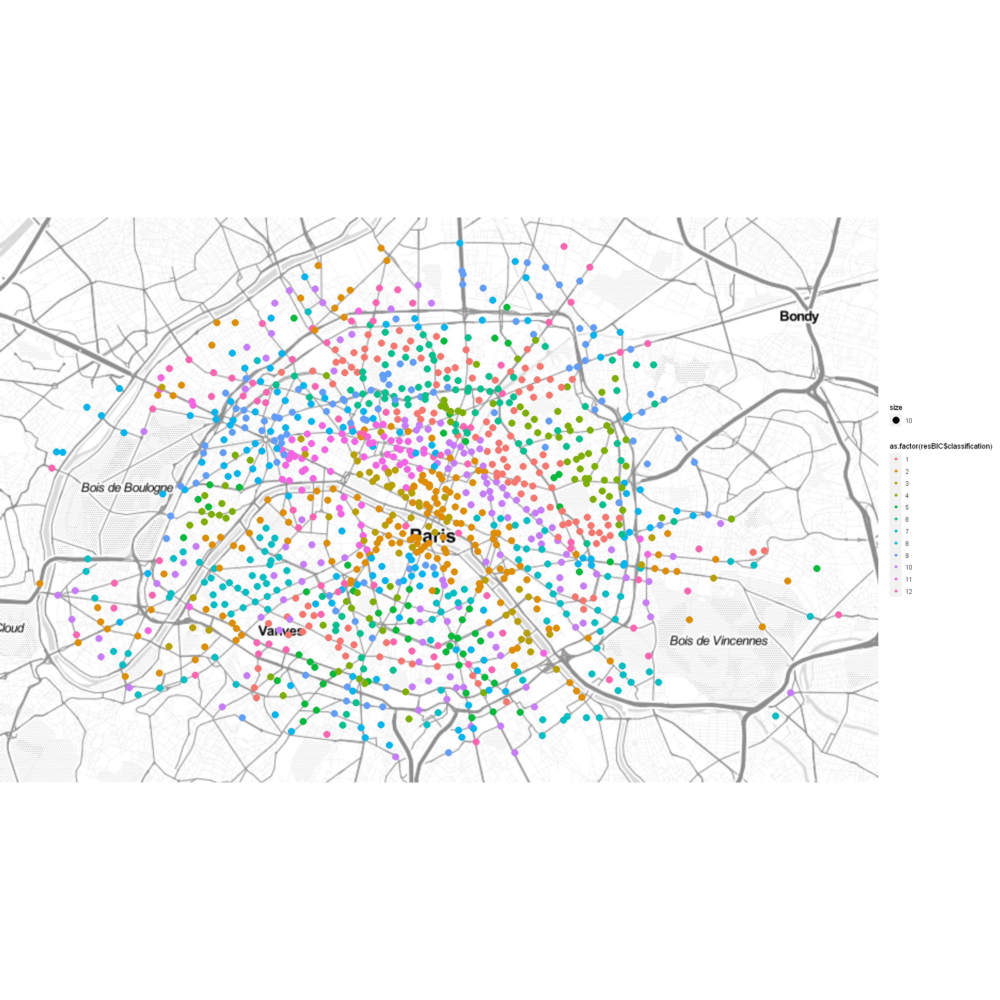

In [346]:
options(repr.plot.width = 20, repr.plot.height = 20)
qmplot(longitude,latitude,data=velib$position,color=as.factor(resBIC$classification),zoom=12,size=10)

# Correspondance Analysis sur CAH, K-Means et Gaussian mixture sur les données  brutes

**Results of the Correspondence Analysis (CA)**
The row variable has  4  categories; the column variable has 4 categories
The chi square of independence between the two variables is equal to 1741.253 (p-value =  0 ).
*The results are available in the following objects:

   name              description                   
1  "$eig"            "eigenvalues"                 
2  "$col"            "results for the columns"     
3  "$col$coord"      "coord. for the columns"      
4  "$col$cos2"       "cos2 for the columns"        
5  "$col$contrib"    "contributions of the columns"
6  "$row"            "results for the rows"        
7  "$row$coord"      "coord. for the rows"         
8  "$row$cos2"       "cos2 for the rows"           
9  "$row$contrib"    "contributions of the rows"   
10 "$call"           "summary called parameters"   
11 "$call$marge.col" "weights of the columns"      
12 "$call$marge.row" "weights of the rows"         

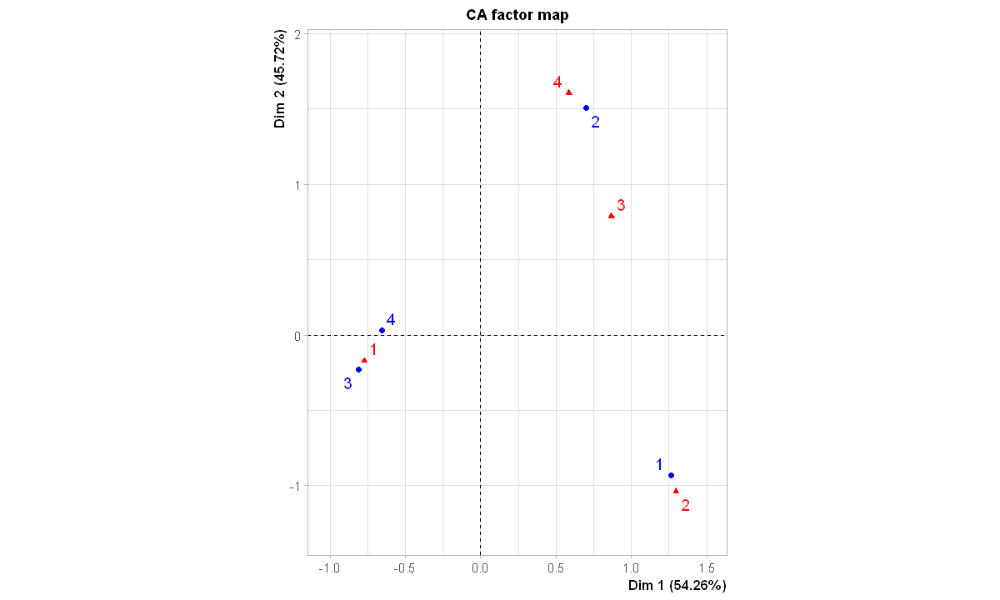

In [400]:
clust_K=reskmeans_brutes$cluster
clust_CAH=ClassK4_brutes
options(repr.plot.width = 10, repr.plot.height = 6)
tab1 <-table(clust_K,clust_CAH)
ca <- CA(tab1)
ca

# Correspondance Analysis sur CAH, K-Means et Gaussian mixture sur les données ACP

In [386]:
clust_G=resBIC$classification
clust_CAH=ClassK4_acp
clust_K=reskmeans_acp$cluster

**Results of the Correspondence Analysis (CA)**
The row variable has  12  categories; the column variable has 4 categories
The chi square of independence between the two variables is equal to 2273.15 (p-value =  0 ).
*The results are available in the following objects:

   name              description                   
1  "$eig"            "eigenvalues"                 
2  "$col"            "results for the columns"     
3  "$col$coord"      "coord. for the columns"      
4  "$col$cos2"       "cos2 for the columns"        
5  "$col$contrib"    "contributions of the columns"
6  "$row"            "results for the rows"        
7  "$row$coord"      "coord. for the rows"         
8  "$row$cos2"       "cos2 for the rows"           
9  "$row$contrib"    "contributions of the rows"   
10 "$call"           "summary called parameters"   
11 "$call$marge.col" "weights of the columns"      
12 "$call$marge.row" "weights of the rows"         

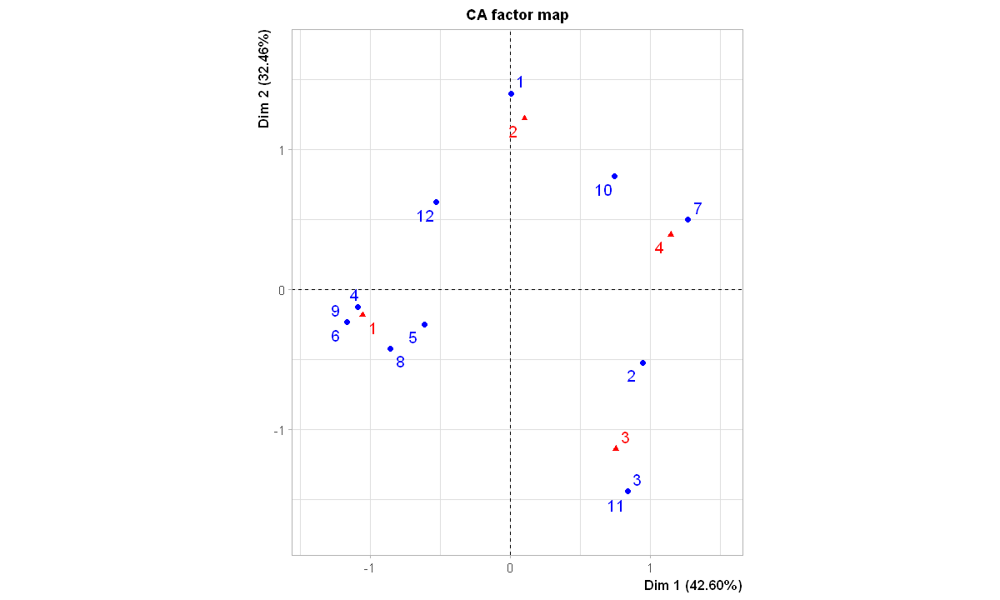

In [395]:
options(repr.plot.width = 10, repr.plot.height = 6)
tab1 <-table(clust_G,clust_CAH)
tab2 <-table(clust_G,clust_K)
tab3 <-table(clust_K,clust_CAH)
ca <- CA(tab1)
ca

**Results of the Correspondence Analysis (CA)**
The row variable has  12  categories; the column variable has 4 categories
The chi square of independence between the two variables is equal to 2317.788 (p-value =  0 ).
*The results are available in the following objects:

   name              description                   
1  "$eig"            "eigenvalues"                 
2  "$col"            "results for the columns"     
3  "$col$coord"      "coord. for the columns"      
4  "$col$cos2"       "cos2 for the columns"        
5  "$col$contrib"    "contributions of the columns"
6  "$row"            "results for the rows"        
7  "$row$coord"      "coord. for the rows"         
8  "$row$cos2"       "cos2 for the rows"           
9  "$row$contrib"    "contributions of the rows"   
10 "$call"           "summary called parameters"   
11 "$call$marge.col" "weights of the columns"      
12 "$call$marge.row" "weights of the rows"         

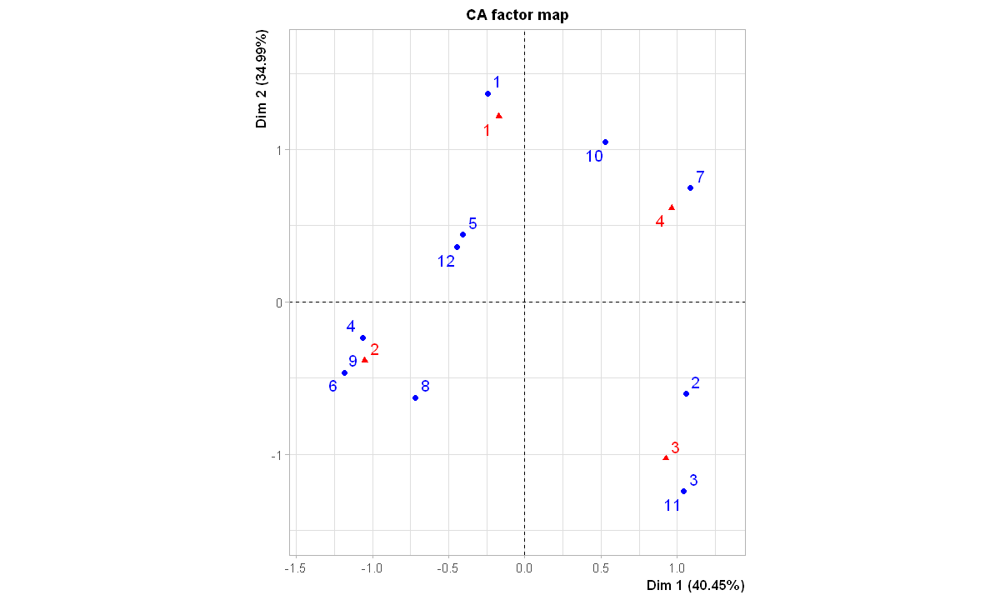

In [396]:
ca <- CA(tab2)
ca


**Results of the Correspondence Analysis (CA)**
The row variable has  4  categories; the column variable has 4 categories
The chi square of independence between the two variables is equal to 2615.441 (p-value =  0 ).
*The results are available in the following objects:

   name              description                   
1  "$eig"            "eigenvalues"                 
2  "$col"            "results for the columns"     
3  "$col$coord"      "coord. for the columns"      
4  "$col$cos2"       "cos2 for the columns"        
5  "$col$contrib"    "contributions of the columns"
6  "$row"            "results for the rows"        
7  "$row$coord"      "coord. for the rows"         
8  "$row$cos2"       "cos2 for the rows"           
9  "$row$contrib"    "contributions of the rows"   
10 "$call"           "summary called parameters"   
11 "$call$marge.col" "weights of the columns"      
12 "$call$marge.row" "weights of the rows"         

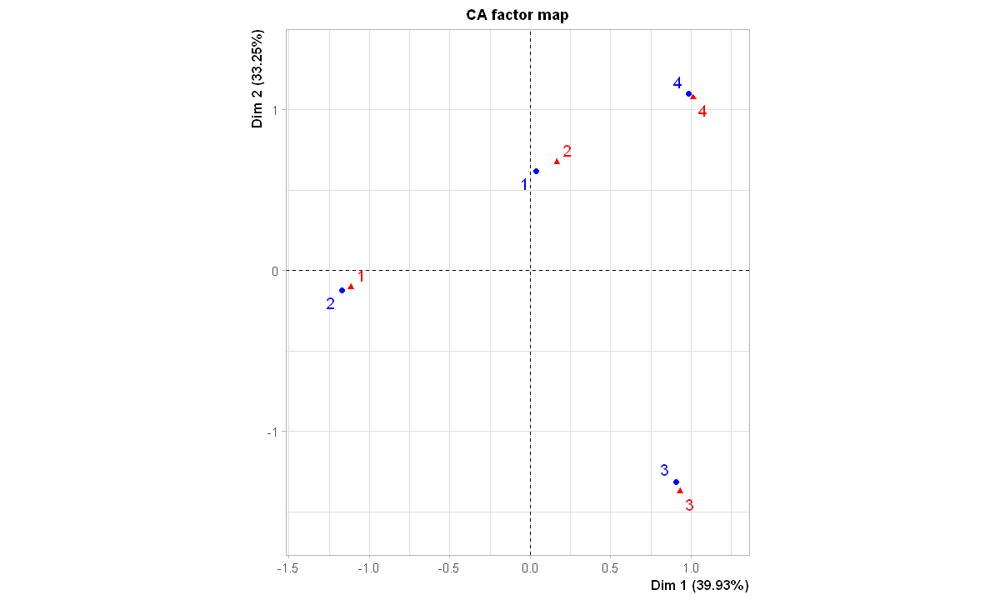

In [397]:
ca <- CA(tab3)
ca
